# Data Preprocessing

In [2]:
import pandas as pd 
import numpy as np 
import matplotlib.pyplot as plt
import plotly.express as px
from sklearn.ensemble import RandomForestRegressor
from xgboost import XGBRegressor
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import PolynomialFeatures
from sklearn.linear_model import Ridge
from sklearn.cluster import KMeans
import folium
import plotly.graph_objects as go

import warnings
warnings.filterwarnings("ignore")
mms = MinMaxScaler()
out = ""#+"output/"

### clustering the data

In [3]:
cluster_data = pd.read_csv(r"C:\Users\user\DS internship\project\Covid-19 Global Forecasting\Countries_usefulFeatures.csv")
data = pd.read_csv(r"C:\Users\user\DS internship\project\Covid-19 Global Forecasting\train.csv")
data2= pd.read_csv(r"C:\Users\user\DS internship\project\Covid-19 Global Forecasting\train2.csv")
country_geo = "world-countries.json"
fd_i = pd.read_csv(r"C:\Users\user\DS internship\project\Covid-19 Global Forecasting\hfi_cc_2019.csv")
testing = pd.read_csv(r"C:\Users\user\DS internship\project\Covid-19 Global Forecasting\tested_worldwide.csv")

confirmed_df = pd.read_csv(r"C:\Users\user\DS internship\project\Covid-19 Global Forecasting\time series\time_series_covid_19_confirmed.csv")
deaths_df = pd.read_csv(r"C:\Users\user\DS internship\project\Covid-19 Global Forecasting\time series\time_series_covid_19_deaths.csv")
recovered_df = pd.read_csv(r"C:\Users\user\DS internship\project\Covid-19 Global Forecasting\time series\time_series_covid_19_recovered.csv")

state_testing = pd.read_csv(r'C:\Users\user\DS internship\project\Covid-19 Global Forecasting\India\StatewiseTestingDetails.csv')
india_covid_19 = pd.read_csv(r'C:\Users\user\DS internship\project\Covid-19 Global Forecasting\India\covid_19_india.csv')


# World Covid-19 Cases

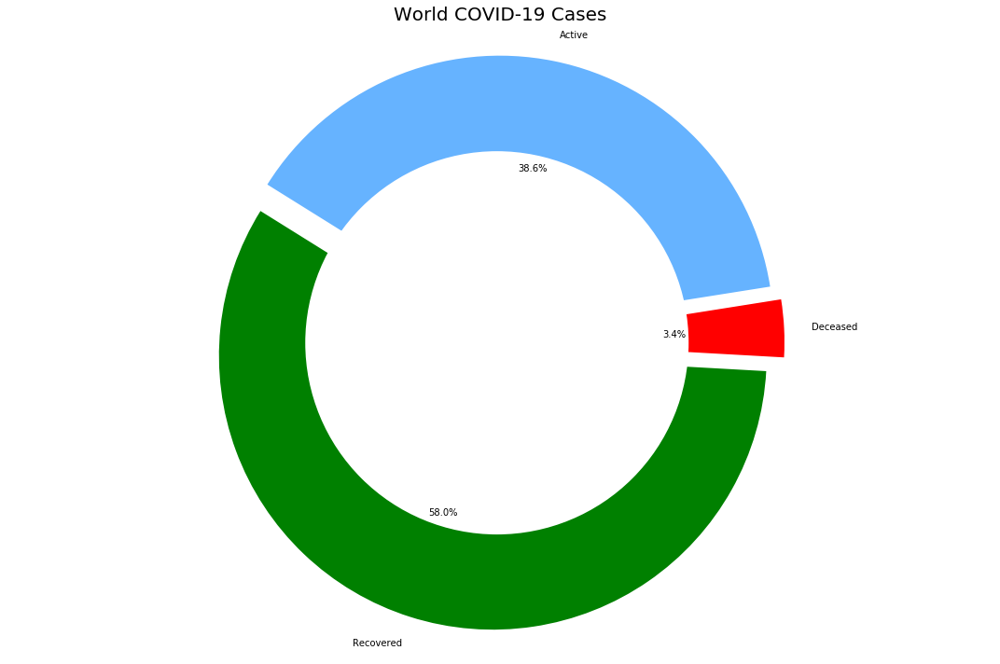

In [4]:
world_confirmed = confirmed_df[confirmed_df.columns[-1:]].sum()
world_recovered = recovered_df[recovered_df.columns[-1:]].sum()
world_deaths = deaths_df[deaths_df.columns[-1:]].sum()
world_active = world_confirmed - (world_recovered - world_deaths)

labels = ['Active','Recovered','Deceased']
sizes = [world_active,world_recovered,world_deaths]
color= ['#66b3ff','green','red']
explode = []

for i in labels:
    explode.append(0.05)
    
plt.figure(figsize= (15,10))
plt.pie(sizes, labels=labels, autopct='%1.1f%%', startangle=9, explode =explode,colors = color)
centre_circle = plt.Circle((0,0),0.70,fc='white')

fig = plt.gcf()
fig.gca().add_artist(centre_circle)
plt.title('World COVID-19 Cases',fontsize = 20)
plt.axis('equal')  
plt.tight_layout()
plt.savefig(out+'world covid-19 cases.png')

In [5]:
max_d_test=testing.groupby(["Country_Region"]).agg({"daily_tested":"max"}).reset_index()

In [6]:
r={
     'Czech Republic': 'Czechia',
     'DR Congo': 'Congo (Brazzaville)',
     'Democratic Republic of the Congo': 'Congo (Kinshasa)',
     'Ivory Coast': "Cote d'Ivoire",
     'Palestine': 'West Bank and Gaza',
     'South Korea': 'Korea, South',
     'Taiwan': 'Taiwan*',
     'United States': 'US',
    }

In [7]:
max_d_test.Country_Region=max_d_test.Country_Region.replace(to_replace=r)

In [8]:
fd_i = fd_i[fd_i.year==2017]
fd_i = fd_i[["ISO_code","pf_score","hf_score"]]

In [9]:
cluster_data.columns

Index(['Country_Region', 'Population_Size', 'Tourism', 'Date_FirstFatality',
       'Date_FirstConfirmedCase', 'Latitude', 'Longtitude', 'Mean_Age',
       'Lockdown_Date', 'Lockdown_Type', 'Country_Code'],
      dtype='object')

In [10]:
data.head()

,Id,Province_State,Country_Region,Date,ConfirmedCases,Fatalities
0,1,NaN,Afghanistan,2020-01-22,0.0,0.0
1,2,NaN,Afghanistan,2020-01-23,0.0,0.0
2,3,NaN,Afghanistan,2020-01-24,0.0,0.0
3,4,NaN,Afghanistan,2020-01-25,0.0,0.0
4,5,NaN,Afghanistan,2020-01-26,0.0,0.0


In [11]:
cluster_data.head()

,Country_Region,Population_Size,Tourism,Date_FirstFatality,Date_FirstConfirmedCase,Latitude,Longtitude,Mean_Age,Lockdown_Date,Lockdown_Type,Country_Code
0,Afghanistan,37172386,14000,2020-03-23,2020-02-25,33.939110,67.709953,17.3,2020-03-24,Full,AFG
1,Albania,2866376,5340000,2020-03-12,2020-03-10,41.153332,20.168331,36.2,2020-03-08,Full,ALB
2,Algeria,42228429,2657000,2020-03-13,2020-02-26,28.033886,1.659626,27.5,2020-03-24,Full,DZA
3,Andorra,77006,3042000,2020-03-23,2020-03-03,42.546245,1.601554,37.0,2020-03-16,Full,AND
4,Angola,30809762,218000,2020-03-30,2020-03-21,-11.202692,17.873887,16.4,NaN,NaN,AGO


In [12]:
data_to_cluster = cluster_data.copy()

In [13]:
data_to_cluster = data_to_cluster[["Country_Region","Population_Size","Tourism","Date_FirstFatality","Date_FirstConfirmedCase","Latitude","Longtitude","Mean_Age"]]

In [14]:
data_to_cluster.isnull().sum()

Country_Region              0
Population_Size             0
Tourism                     0
Date_FirstFatality         28
Date_FirstConfirmedCase     0
Latitude                    0
Longtitude                  0
Mean_Age                    0
dtype: int64

In [15]:
data_to_cluster.Date_FirstFatality.fillna("2222-11-11",inplace=True)
data_to_cluster.Date_FirstFatality=pd.to_datetime(data_to_cluster.Date_FirstFatality)
data_to_cluster.Date_FirstFatality = data_to_cluster.Date_FirstFatality.astype(np.int64) // 10**9
data_to_cluster.Date_FirstConfirmedCase=pd.to_datetime(data_to_cluster.Date_FirstConfirmedCase)
data_to_cluster.Date_FirstConfirmedCase = data_to_cluster.Date_FirstConfirmedCase.astype(np.int64) // 10**9

In [16]:
data_to_cluster.drop(["Country_Region"],axis=1,inplace=True)

In [17]:
mms.fit(data_to_cluster)
data_transformed = mms.transform(data_to_cluster)

### Checking for the optimal K in Kmeans Clustering

In [18]:
Sum_of_squared_distances = []
K = range(1,90)
for k in K:
    km = KMeans(n_clusters=k)
    km = km.fit(data_transformed)
    Sum_of_squared_distances.append(km.inertia_)

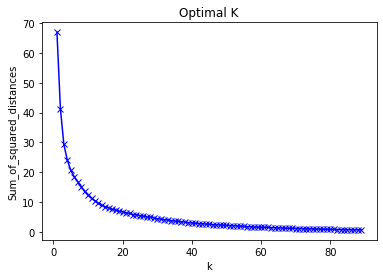

In [19]:
import matplotlib.pyplot as plt
plt.plot(K, Sum_of_squared_distances, 'bx-')
plt.xlabel('k')
plt.ylabel('Sum_of_squared_distances')
plt.title('Optimal K')
plt.show()

In [20]:
km = KMeans(n_clusters=55,random_state=1995)
km = km.fit(data_transformed)

In [21]:
cluster_data["cluster"] = km.labels_

In [22]:
data.drop("Province_State",axis=1,inplace=True)

In [23]:
data = pd.merge(data,cluster_data,on='Country_Region',how="left")

Creating other useful columns

In [24]:
data.columns

Index(['Id', 'Country_Region', 'Date', 'ConfirmedCases', 'Fatalities',
       'Population_Size', 'Tourism', 'Date_FirstFatality',
       'Date_FirstConfirmedCase', 'Latitude', 'Longtitude', 'Mean_Age',
       'Lockdown_Date', 'Lockdown_Type', 'Country_Code', 'cluster'],
      dtype='object')

In [25]:
temp_data = data.groupby(["Country_Region","Date"]).agg({"ConfirmedCases":"sum","Fatalities":"sum"}).reset_index()
temp_data.columns = ["Country_Region","Date","ConfirmedCases_i","Fatalities_i"]
data.drop_duplicates(["Country_Region","Date"],inplace=True)
data = pd.merge(data,temp_data,on=['Country_Region',"Date"],how="left")
data.drop(["ConfirmedCases","Fatalities"],axis=1,inplace=True)
data.rename(columns={"ConfirmedCases_i":"ConfirmedCases","Fatalities_i":"Fatalities","clusters":"cluster"},inplace=True)

#### Fatalities percentage

In [26]:
data.Date_FirstFatality.fillna("2222-11-11",inplace=True)

In [27]:
data.isnull().sum()

Id                            0
Country_Region                0
Date                          0
Population_Size               0
Tourism                       0
Date_FirstFatality            0
Date_FirstConfirmedCase       0
Latitude                      0
Longtitude                    0
Mean_Age                      0
Lockdown_Date              3795
Lockdown_Type              3795
Country_Code                  0
cluster                       0
ConfirmedCases                0
Fatalities                    0
dtype: int64

In [28]:
data["Fatalities_rate"]=(data.Fatalities * 100) / data.ConfirmedCases

#### Difference between Lockdown Date and First Confirmed Case Date

In [29]:
data["diff_FC_LD"]=(data.Lockdown_Date.astype('datetime64') - data.Date_FirstConfirmedCase.astype('datetime64'))


#### Difference between Lockdown Date and First Confirmed Fatality

In [30]:
data["diff_FF_LD"]=(data.Lockdown_Date.astype('datetime64') - data.Date_FirstFatality.astype('datetime64'))

In [31]:
tempd2=data2.loc[(data2.Target=="ConfirmedCases"),["Country_Region","Weight"]]

In [32]:
tempd2["Weight_F"] =  data2.loc[(data2.Target=="Fatalities"),["Weight"]].values

In [33]:
tempd2.columns = ["Country_Region","Weight_C","Weight_F"]

In [34]:
tempd2=tempd2.drop_duplicates(["Country_Region"])

In [35]:
data = pd.merge(data,tempd2[["Country_Region","Weight_C","Weight_F"]],on=['Country_Region'],how="left")

In [36]:
fd_i.columns = ["Country_Code","pf_score","hf_score"]

In [37]:
data = pd.merge(data,max_d_test[["Country_Region","daily_tested"]],on=['Country_Region'],how="left")

In [38]:
data=pd.merge(data,fd_i[["Country_Code","pf_score","hf_score"]],on=['Country_Code'],how="left")

In [39]:
data.daily_tested.fillna(data.loc[data.daily_tested>100,"daily_tested"].min(),inplace=True)

In [40]:
data.hf_score.fillna(data.hf_score.median(),inplace=True)
data.pf_score.fillna(data.pf_score.median(),inplace=True)

In [41]:
df_covid19 = pd.read_csv(r"C:\Users\user\DS internship\project\Covid-19 Global Forecasting\cases_country.csv")
df_confirmed = pd.read_csv(r'C:\Users\user\DS internship\project\Covid-19 Global Forecasting\time series\time_series_covid_19_confirmed.csv')
df_deaths = pd.read_csv(r'C:\Users\user\DS internship\project\Covid-19 Global Forecasting\time series\time_series_covid_19_deaths.csv')

# Depricated
# df_recovered = pd.read_csv(r'C:\Users\user\DS internship\project\Covid-19 Global Forecasting\time series\time_series_19-covid-Recovered.csv')
df_table = pd.read_csv(r"C:\Users\user\DS internship\project\Covid-19 Global Forecasting\cases_time.csv",parse_dates=['Last_Update'])
df_confirmed = df_confirmed.rename(columns={"Province/State":"state","Country/Region": "country"})
df_deaths = df_deaths.rename(columns={"Province/State":"state","Country/Region": "country"})
df_covid19 = df_covid19.rename(columns={"Country_Region": "country"})
df_covid19["Active"] = df_covid19["Confirmed"]-df_covid19["Recovered"]-df_covid19["Deaths"]
# df_recovered = df_recovered.rename(columns={"Province/State":"state","Country/Region": "country"})
df_covid19 = df_covid19.drop(["People_Tested","People_Hospitalized","UID","ISO3","Mortality_Rate"],axis =1)


In [42]:
import numpy as np
# Changing the conuntry names as required by pycountry_convert Lib
df_confirmed.loc[df_confirmed['country'] == "US", "country"] = "USA"
df_deaths.loc[df_deaths['country'] == "US", "country"] = "USA"
df_covid19.loc[df_covid19['country'] == "US", "country"] = "USA"
df_table.loc[df_table['Country_Region'] == "US", "Country_Region"] = "USA"
# df_recovered.loc[df_recovered['country'] == "US", "country"] = "USA"


df_confirmed.loc[df_confirmed['country'] == 'Korea, South', "country"] = 'South Korea'
df_deaths.loc[df_deaths['country'] == 'Korea, South', "country"] = 'South Korea'
df_covid19.loc[df_covid19['country'] == "Korea, South", "country"] = "South Korea"
df_table.loc[df_table['Country_Region'] == "Korea, South", "Country_Region"] = "South Korea"
# df_recovered.loc[df_recovered['country'] == 'Korea, South', "country"] = 'South Korea'

df_confirmed.loc[df_confirmed['country'] == 'Taiwan*', "country"] = 'Taiwan'
df_deaths.loc[df_deaths['country'] == 'Taiwan*', "country"] = 'Taiwan'
df_covid19.loc[df_covid19['country'] == "Taiwan*", "country"] = "Taiwan"
df_table.loc[df_table['Country_Region'] == "Taiwan*", "Country_Region"] = "Taiwan"
# df_recovered.loc[df_recovered['country'] == 'Taiwan*', "country"] = 'Taiwan'

df_confirmed.loc[df_confirmed['country'] == 'Congo (Kinshasa)', "country"] = 'Democratic Republic of the Congo'
df_deaths.loc[df_deaths['country'] == 'Congo (Kinshasa)', "country"] = 'Democratic Republic of the Congo'
df_covid19.loc[df_covid19['country'] == "Congo (Kinshasa)", "country"] = "Democratic Republic of the Congo"
df_table.loc[df_table['Country_Region'] == "Congo (Kinshasa)", "Country_Region"] = "Democratic Republic of the Congo"
# df_recovered.loc[df_recovered['country'] == 'Congo (Kinshasa)', "country"] = 'Democratic Republic of the Congo'

df_confirmed.loc[df_confirmed['country'] == "Cote d'Ivoire", "country"] = "Côte d'Ivoire"
df_deaths.loc[df_deaths['country'] == "Cote d'Ivoire", "country"] = "Côte d'Ivoire"
df_covid19.loc[df_covid19['country'] == "Cote d'Ivoire", "country"] = "Côte d'Ivoire"
df_table.loc[df_table['Country_Region'] == "Cote d'Ivoire", "Country_Region"] = "Côte d'Ivoire"
# df_recovered.loc[df_recovered['country'] == "Cote d'Ivoire", "country"] = "Côte d'Ivoire"

df_confirmed.loc[df_confirmed['country'] == "Reunion", "country"] = "Réunion"
df_deaths.loc[df_deaths['country'] == "Reunion", "country"] = "Réunion"
df_covid19.loc[df_covid19['country'] == "Reunion", "country"] = "Réunion"
df_table.loc[df_table['Country_Region'] == "Reunion", "Country_Region"] = "Réunion"
# df_recovered.loc[df_recovered['country'] == "Reunion", "country"] = "Réunion"

df_confirmed.loc[df_confirmed['country'] == 'Congo (Brazzaville)', "country"] = 'Republic of the Congo'
df_deaths.loc[df_deaths['country'] == 'Congo (Brazzaville)', "country"] = 'Republic of the Congo'
df_covid19.loc[df_covid19['country'] == "Congo (Brazzaville)", "country"] = "Republic of the Congo"
df_table.loc[df_table['Country_Region'] == "Congo (Brazzaville)", "Country_Region"] = "Republic of the Congo"
# df_recovered.loc[df_recovered['country'] == 'Congo (Brazzaville)', "country"] = 'Republic of the Congo'

df_confirmed.loc[df_confirmed['country'] == 'Bahamas, The', "country"] = 'Bahamas'
df_deaths.loc[df_deaths['country'] == 'Bahamas, The', "country"] = 'Bahamas'
df_covid19.loc[df_covid19['country'] == "Bahamas, The", "country"] = "Bahamas"
df_table.loc[df_table['Country_Region'] == "Bahamas, The", "Country_Region"] = "Bahamas"
# df_recovered.loc[df_recovered['country'] == 'Bahamas, The', "country"] = 'Bahamas'

df_confirmed.loc[df_confirmed['country'] == 'Gambia, The', "country"] = 'Gambia'
df_deaths.loc[df_deaths['country'] == 'Gambia, The', "country"] = 'Gambia'
df_covid19.loc[df_covid19['country'] == "Gambia, The", "country"] = "Gambia"
df_table.loc[df_table['Country_Region'] == "Gambia", "Country_Region"] = "Gambia"
# df_recovered.loc[df_recovered['country'] == 'Gambia, The', "country"] = 'Gambia'

# getting all countries
countries = np.asarray(df_confirmed["country"])
countries1 = np.asarray(df_covid19["country"])
# Continent_code to Continent_names
continents = {
    'NA': 'North America',
    'SA': 'South America', 
    'AS': 'Asia',
    'OC': 'Australia',
    'AF': 'Africa',
    'EU' : 'Europe',
    'na' : 'Others'
}

# Defininng Function for getting continent code for country.
def country_to_continent_code(country):
    try:
        return pc.country_alpha2_to_continent_code(pc.country_name_to_country_alpha2(country))
    except :
        return 'na'

#Collecting Continent Information
df_confirmed.insert(2,"continent", [continents[country_to_continent_code(country)] for country in countries[:]])
df_deaths.insert(2,"continent",  [continents[country_to_continent_code(country)] for country in countries[:]])
df_covid19.insert(1,"continent",  [continents[country_to_continent_code(country)] for country in countries1[:]])
df_table.insert(1,"continent",  [continents[country_to_continent_code(country)] for country in df_table["Country_Region"].values])
# df_recovered.insert(2,"continent",  [continents[country_to_continent_code(country)] for country in countries[:]] )   

In [43]:
df_countries_cases = df_covid19.copy().drop(['Lat','Long_','continent','Last_Update'],axis =1)
df_countries_cases.index = df_countries_cases["country"]
df_countries_cases = df_countries_cases.drop(['country'],axis=1)

df_continents_cases = df_covid19.copy().drop(['Lat','Long_','country','Last_Update'],axis =1)
df_continents_cases = df_continents_cases.groupby(["continent"]).sum()

df_countries_cases.fillna(0,inplace=True)
df_continents_cases.fillna(0,inplace=True)

# Global Reported Cases 
Total number of confirmed cases, deaths reported, revoveries and active cases all across the world

In [44]:
df_t = pd.DataFrame(pd.to_numeric(df_countries_cases.sum()),dtype=np.float64).transpose()
df_t["Mortality Rate (per 100)"] = np.round(100*df_t["Deaths"]/df_t["Confirmed"],2)
df_t.style.background_gradient(cmap='Wistia',axis=1).format("{:.2f}").format("{:.0f}",subset=["Confirmed","Deaths","Recovered","Active"])


,Confirmed,Deaths,Recovered,Active,Incident_Rate,Mortality Rate (per 100)
0,23206319,804444,14913639,7378118,68493.86,3.47


# Continent Wise Reported Cases
Continent Wise reported confirmed cases, recovered cases, deaths, active cases

In [45]:
# df_countries_cases.sort_values('Confirmed', ascending= False).style.background_gradient(cmap='Wistia')
df_countries_cases["Mortality Rate (per 100)"] = np.round(100*df_countries_cases["Deaths"]/df_countries_cases["Confirmed"],2)
df_countries_cases.sort_values('Confirmed', ascending= False).style.background_gradient(cmap='Blues',subset=["Confirmed"])\
                        .background_gradient(cmap='Reds',subset=["Deaths"])\
                        .background_gradient(cmap='Greens',subset=["Recovered"])\
                        .background_gradient(cmap='Purples',subset=["Active"])\
                        .background_gradient(cmap='Pastel1_r',subset=["Incident_Rate"])\
                        .background_gradient(cmap='YlOrBr',subset=["Mortality Rate (per 100)"])\
                        .format("{:.2f}")\
                        .format("{:.0f}",subset=["Confirmed","Deaths","Recovered","Active"])
plt.savefig(out+'.png')

<Figure size 432x288 with 0 Axes>

# Top 10 countries (Confirmed Cases and Deaths)

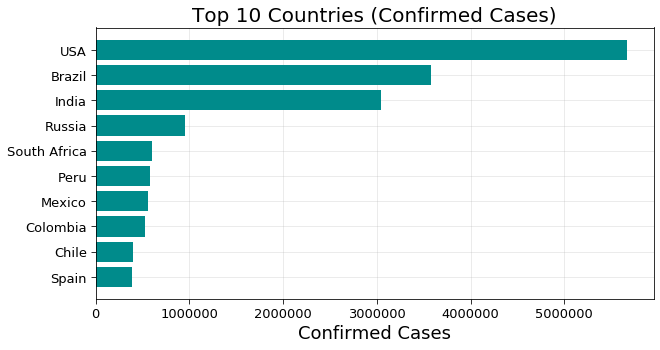

In [46]:
import matplotlib.pyplot as plt
out = ""#+"output/"
df_countries_cases = df_covid19.copy().drop(['Lat','Long_','continent','Last_Update'],axis =1)
df_countries_cases.index = df_countries_cases["country"]
df_countries_cases = df_countries_cases.drop(['country'],axis=1)
df_countries_cases.fillna(0,inplace=True)

f = plt.figure(figsize=(10,5))
f.add_subplot(111)

plt.axes(axisbelow=True)
plt.barh(df_countries_cases.sort_values('Confirmed')["Confirmed"].index[-10:],df_countries_cases.sort_values('Confirmed')["Confirmed"].values[-10:],color="darkcyan")
plt.tick_params(size=5,labelsize = 13)
plt.xlabel("Confirmed Cases",fontsize=18)
plt.title("Top 10 Countries (Confirmed Cases)",fontsize=20)
plt.grid(alpha=0.3)
plt.savefig(out+'Top 10 Countries (Confirmed Cases).png')

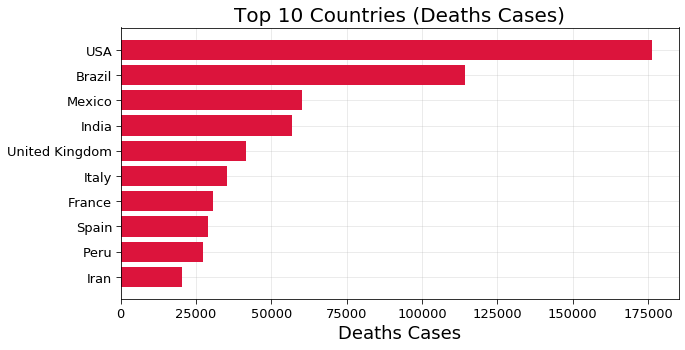

In [47]:
f = plt.figure(figsize=(10,5))
f.add_subplot(111)

plt.axes(axisbelow=True)
plt.barh(df_countries_cases.sort_values('Deaths')["Deaths"].index[-10:],df_countries_cases.sort_values('Deaths')["Deaths"].values[-10:],color="crimson")
plt.tick_params(size=5,labelsize = 13)
plt.xlabel("Deaths Cases",fontsize=18)
plt.title("Top 10 Countries (Deaths Cases)",fontsize=20)
plt.grid(alpha=0.3,which='both')
plt.savefig(out+'Top 10 Countries (Deaths Cases).png')

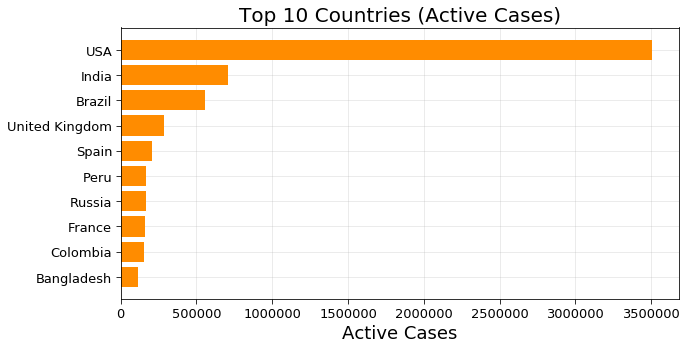

In [48]:
f = plt.figure(figsize=(10,5))
f.add_subplot(111)

plt.axes(axisbelow=True)
plt.barh(df_countries_cases.sort_values('Active')["Active"].index[-10:],df_countries_cases.sort_values('Active')["Active"].values[-10:],color="darkorange")
plt.tick_params(size=5,labelsize = 13)
plt.xlabel("Active Cases",fontsize=18)
plt.title("Top 10 Countries (Active Cases)",fontsize=20)
plt.grid(alpha=0.3,which='both')
plt.savefig(out+'Top 10 Countries (Active Cases).png')

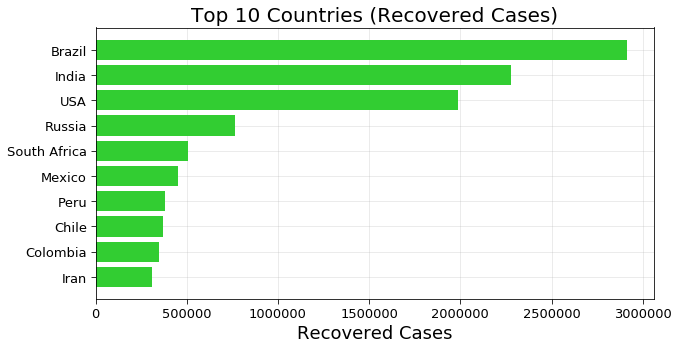

In [49]:
f = plt.figure(figsize=(10,5))
f.add_subplot(111)

plt.axes(axisbelow=True)
plt.barh(df_countries_cases.sort_values('Recovered')["Recovered"].index[-10:],df_countries_cases.sort_values('Recovered')["Recovered"].values[-10:],color="limegreen")
plt.tick_params(size=5,labelsize = 13)
plt.xlabel("Recovered Cases",fontsize=18)
plt.title("Top 10 Countries (Recovered Cases)",fontsize=20)
plt.grid(alpha=0.3,which='both')
plt.savefig(out+'Top 10 Countries (Recovered Cases).png')

# Correlation Analysis
 Plotting Heat map of correlation of confirmed cases, recovered cases, deaths and active cases.
## Country wise Correlation

In [50]:
df_countries_cases.iloc[:,:].corr().style.background_gradient(cmap='Reds').format("{:.3f}")

,Confirmed,Deaths,Recovered,Active,Incident_Rate
Confirmed,1.000,0.941,0.923,0.890,0.282
Deaths,0.941,1.000,0.841,0.862,0.280
Recovered,0.923,0.841,1.000,0.646,0.283
Active,0.890,0.862,0.646,1.000,0.222
Incident_Rate,0.282,0.280,0.283,0.222,1.000


# Global Confirmed Cases Heat Map

In [51]:
temp_df = pd.DataFrame(df_countries_cases['Confirmed'])
temp_df = temp_df.reset_index()
fig = px.choropleth(temp_df, locations="country",
                    color=np.log10(temp_df["Confirmed"]), # lifeExp is a column of gapminder
                    hover_name="country", # column to add to hover information
                    hover_data=["Confirmed"],
                    color_continuous_scale=px.colors.sequential.Plasma,locationmode="country names")
fig.update_geos(fitbounds="locations", visible=False)
fig.update_layout(title_text="Confirmed Cases Heat Map (Log Scale)")
fig.update_coloraxes(colorbar_title="Confirmed Cases(Log Scale)",colorscale="Blues")
plt.savefig(out+"Global Heat Map confirmed.png")
fig.show()

<Figure size 432x288 with 0 Axes>

# Global Deaths Heat Map


In [52]:
temp_df = pd.DataFrame(df_countries_cases['Deaths'])
temp_df = temp_df.reset_index()
fig = px.choropleth(temp_df, locations="country",
                    color=np.log10(temp_df["Deaths"]+1), # lifeExp is a column of gapminder
                    hover_name="country", # column to add to hover information
                    hover_data=["Deaths"],
                    color_continuous_scale=px.colors.sequential.Plasma,locationmode="country names")
fig.update_geos(fitbounds="locations", visible=False)
fig.update_layout(title_text="Deaths Heat Map (Log Scale)")
fig.update_coloraxes(colorbar_title="Deaths (Log Scale)",colorscale="Reds")
plt.savefig(out+"Global Heat Map deaths.png")
fig.show()

<Figure size 432x288 with 0 Axes>

# Global Recovered Heat Map

In [53]:
temp_df = pd.DataFrame(df_countries_cases['Recovered'])
temp_df = temp_df.reset_index()
fig = px.choropleth(temp_df, locations="country",
                    color=np.log10(temp_df.iloc[:,-1]+1), # lifeExp is a column of gapminder
                    hover_name="country", # column to add to hover information
                    hover_data=["Recovered"],
                    color_continuous_scale=px.colors.sequential.Plasma,locationmode="country names")
fig.update_geos(fitbounds="locations", visible=False)
fig.update_layout(title_text="Recovered Heat Map (Log Scale)")
fig.update_coloraxes(colorbar_title="Recovered",colorscale="Greens")
plt.savefig(out+"Global Heat Map recovered.png")
fig.show()

<Figure size 432x288 with 0 Axes>

# COVID-19: Spread Progression

In [54]:
df_data = df_table.groupby(['Last_Update', 'Country_Region'])['Confirmed', 'Deaths'].max().reset_index().fillna(0)
df_data["Last_Update"] = pd.to_datetime( df_data["Last_Update"]).dt.strftime('%m/%d/%Y')

fig = px.scatter_geo(df_data, locations="Country_Region", locationmode='country names', 
                     color=np.power(df_data["Confirmed"],0.3)-2 , size= np.power(df_data["Confirmed"]+1,0.3)-1, hover_name="Country_Region",
                     hover_data=["Confirmed"],
                     range_color= [0, max(np.power(df_data["Confirmed"],0.3))], 
                     projection="natural earth", animation_frame="Last_Update", 
                     color_continuous_scale=px.colors.sequential.Plasma,
                     title='COVID-19: Progression of spread'
                    )
fig.update_coloraxes(colorscale="hot")
fig.update(layout_coloraxis_showscale=False)
fig.show()

In [55]:
def visualize_covid_cases(confirmed, deaths, continent=None , country = None , state = None, period = None, figure = None, scale = "linear"):
    x = 0
    if figure == None:
        f = plt.figure(figsize=(10,10))
        # Sub plot
        ax = f.add_subplot(111)
    else :
        f = figure[0]
        # Sub plot
        ax = f.add_subplot(figure[1],figure[2],figure[3])
    ax.set_axisbelow(True)
    plt.tight_layout(pad=10, w_pad=5, h_pad=5)
    
    stats = [confirmed, deaths]
    label = ["Confirmed", "Deaths"]
    
    if continent != None:
        params = ["continent",continent]
    elif country != None:
        params = ["country",country]
    else: 
        params = ["All", "All"]
    color = ["darkcyan","crimson"]
    marker_style = dict(linewidth=3, linestyle='-', marker='o',markersize=4, markerfacecolor='#ffffff')
    for i,stat in enumerate(stats):
        if params[1] == "All" :
            cases = np.sum(np.asarray(stat.iloc[:,5:]),axis = 0)[x:]
        else :
            cases = np.sum(np.asarray(stat[stat[params[0]] == params[1]].iloc[:,5:]),axis = 0)[x:]
        date = np.arange(1,cases.shape[0]+1)[x:]
        plt.plot(date,cases,label = label[i]+" (Total : "+str(cases[-1])+")",color=color[i],**marker_style)
        plt.fill_between(date,cases,color=color[i],alpha=0.3)

    if params[1] == "All" :
        Total_confirmed = np.sum(np.asarray(stats[0].iloc[:,5:]),axis = 0)[x:]
        Total_deaths = np.sum(np.asarray(stats[1].iloc[:,5:]),axis = 0)[x:]
    else :
        Total_confirmed =  np.sum(np.asarray(stats[0][stat[params[0]] == params[1]].iloc[:,5:]),axis = 0)[x:]
        Total_deaths = np.sum(np.asarray(stats[1][stat[params[0]] == params[1]].iloc[:,5:]),axis = 0)[x:]
        
    text = "From "+stats[0].columns[5]+" to "+stats[0].columns[-1]+"\n"
    text += "Mortality rate : "+ str(int(Total_deaths[-1]/(Total_confirmed[-1])*10000)/100)+"\n"
    text += "Last 5 Days:\n"
    text += "Confirmed : " + str(Total_confirmed[-1] - Total_confirmed[-6])+"\n"
    text += "Deaths : " + str(Total_deaths[-1] - Total_deaths[-6])+"\n"
    text += "Last 24 Hours:\n"
    text += "Confirmed : " + str(Total_confirmed[-1] - Total_confirmed[-2])+"\n"
    text += "Deaths : " + str(Total_deaths[-1] - Total_deaths[-2])+"\n"
    
    plt.text(0.02, 0.78, text, fontsize=15, horizontalalignment='left', verticalalignment='top', transform=ax.transAxes,bbox=dict(facecolor='white', alpha=0.4))
    
    # Plot Axes Labels
    axis_label = ["Days ("+df_confirmed.columns[5]+" - "+df_confirmed.columns[-1]+")","No of Cases"]
    
    # Plot Parameters
    plot_params(ax,axis_label,scale = scale)
    
    # Plot Title
    if params[1] == "All" :
        plt.title("COVID-19 Cases World",{'fontsize':25})
    else:   
        plt.title("COVID-19: "+params[1] ,{'fontsize':25})
        
    # Legend Location
    l = plt.legend(loc= "best",fontsize = 15)
    
    if figure == None:
        plt.show()


In [56]:
def plot_params(ax,axis_label= None, plt_title = None,label_size=15, axis_fsize = 15, title_fsize = 20, scale = 'linear' ):
    # Tick-Parameters
    ax.xaxis.set_minor_locator(ticker.AutoMinorLocator())
    ax.yaxis.set_minor_locator(ticker.AutoMinorLocator())
    ax.tick_params(which='both', width=1,labelsize=label_size)
    ax.tick_params(which='major', length=6)
    ax.tick_params(which='minor', length=3, color='0.8')
    
    # Grid
    plt.grid(lw = 1, ls = '-', c = "0.7", which = 'major')
    plt.grid(lw = 1, ls = '-', c = "0.9", which = 'minor')

    # Plot Title
    plt.title( plt_title,{'fontsize':title_fsize})
    
    # Yaxis sacle
    plt.yscale(scale)
    plt.minorticks_on()
    # Plot Axes Labels
    xl = plt.xlabel(axis_label[0],fontsize = axis_fsize)
    yl = plt.ylabel(axis_label[1],fontsize = axis_fsize)

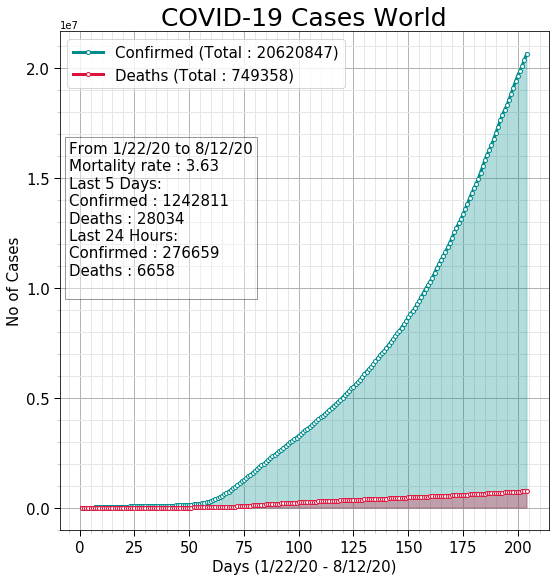

In [57]:
from matplotlib import ticker
cols = 1
rows = 1
f = plt.figure(figsize=(10,10*rows))

visualize_covid_cases(df_confirmed, df_deaths,continent = "All",figure = [f,rows,cols, 1])
plt.savefig(out+'covid_casesworld.png')
plt.show()

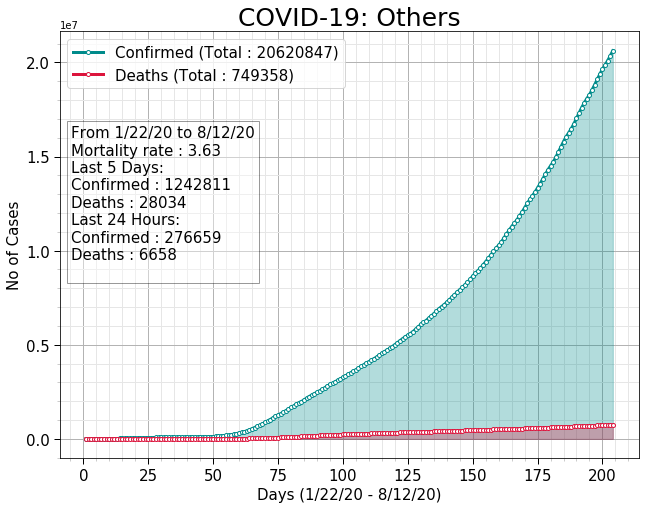

In [58]:
df_continents= df_confirmed.groupby(["continent"]).sum()
continents = df_continents.sort_values(df_continents.columns[-1],ascending = False).index

cols =2
rows = int(np.ceil(continents.shape[0]/cols))
f = plt.figure(figsize=(20,9*rows))
for i,continent in enumerate(continents):
    visualize_covid_cases(df_confirmed, df_deaths, continent = continent,figure = [f,rows,cols, i+1])
plt.savefig(out+'covid_others.png')
plt.show()

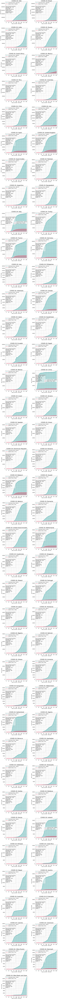

In [59]:
df_countries = df_confirmed.groupby(["country"]).sum()
df_countries = df_countries.sort_values(df_countries.columns[-1],ascending = False)
countries = df_countries[df_countries[df_countries.columns[-1]] >= 15000].index

cols =2
rows = int(np.ceil(countries.shape[0]/cols))
f = plt.figure(figsize=(18,7*rows))
for i,country in enumerate(countries):
    visualize_covid_cases(df_confirmed, df_deaths,country = country,figure = [f,rows,cols, i+1])
plt.savefig(out+'covid_somecountries.png')
plt.show()

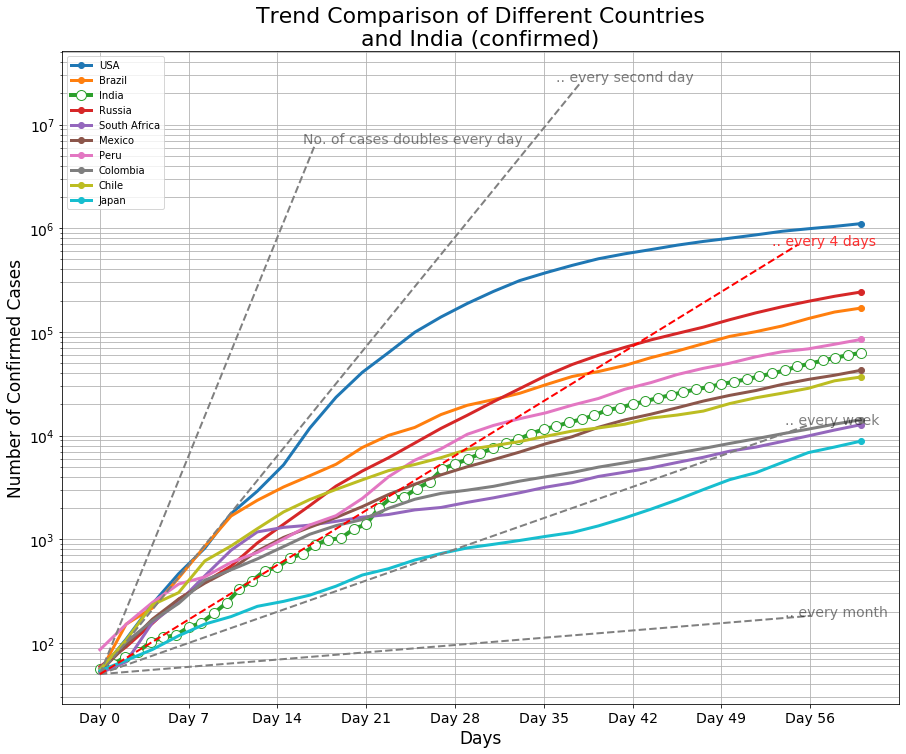

In [60]:
from scipy.interpolate import make_interp_spline, BSpline
temp = df_confirmed.groupby('country').sum().drop(["Lat","Long"],axis =1).sort_values(df_confirmed.columns[-1], ascending= False)

threshold = 50
f = plt.figure(figsize=(15,12))
ax = f.add_subplot(111)
for i,country in enumerate(temp.index):
    if i >= 9:
        if country != "India" and country != "Japan" :
            continue
    days = 61
    t = temp.loc[temp.index== country].values[0]
    t = t[t>threshold][:days]
     
    date = np.arange(0,len(t[:days]))
    xnew = np.linspace(date.min(), date.max(), 30)
    spl = make_interp_spline(date, t, k=1)  # type: BSpline
    power_smooth = spl(xnew)
    if country != "India":
        plt.plot(xnew,power_smooth,'-o',label = country,linewidth =3, markevery=[-1])
    else:
        marker_style = dict(linewidth=4, linestyle='-', marker='o',markersize=10, markerfacecolor='#ffffff')
        plt.plot(date,t,"-.",label = country,**marker_style)

plt.tick_params(labelsize = 14)        
plt.xticks(np.arange(0,days,7),[ "Day "+str(i) for i in range(days)][::7])     

# Reference lines 
x = np.arange(0,18)
y = 2**(x+np.log2(threshold))
plt.plot(x,y,"--",linewidth =2,color = "gray")
plt.annotate("No. of cases doubles every day",(x[-2],y[-1]),xycoords="data",fontsize=14,alpha = 0.5)

x = np.arange(0,int(days-22))
y = 2**(x/2+np.log2(threshold))
plt.plot(x,y,"--",linewidth =2,color = "gray")
plt.annotate(".. every second day",(x[-3],y[-1]),xycoords="data",fontsize=14,alpha = 0.5)

x = np.arange(0,int(days-4))
y = 2**(x/7+np.log2(threshold))
plt.plot(x,y,"--",linewidth =2,color = "gray")
plt.annotate(".. every week",(x[-3],y[-1]),xycoords="data",fontsize=14,alpha = 0.5)

x = np.arange(0,int(days-4))
y = 2**(x/30+np.log2(threshold))
plt.plot(x,y,"--",linewidth =2,color = "gray")
plt.annotate(".. every month",(x[-3],y[-1]),xycoords="data",fontsize=14,alpha = 0.5)


# India is following trend similar to doulbe the cases in 4 days but it may increase the rate 
x = np.arange(0,int(days-5))
y = 2**(x/4+np.log2(threshold))
plt.plot(x,y,"--",linewidth =2,color = "Red")
plt.annotate(".. every 4 days",(x[-3],y[-1]),color="Red",xycoords="data",fontsize=14,alpha = 0.8)

# plot Params
plt.xlabel("Days",fontsize=17)
plt.ylabel("Number of Confirmed Cases",fontsize=17)
plt.title("Trend Comparison of Different Countries\n and India (confirmed) ",fontsize=22)
plt.legend(loc = "upper left")
plt.yscale("log")
plt.grid(which="both")
plt.savefig(out+'Trend Comparison with India (confirmed).png')
plt.show()

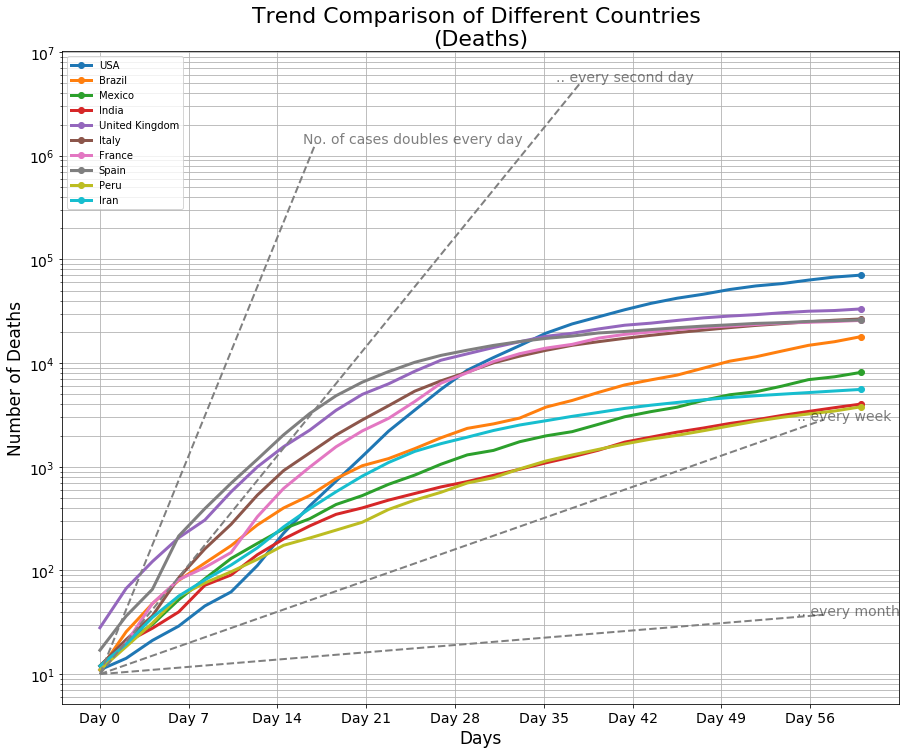

In [61]:
temp = df_deaths.groupby('country').sum().drop(["Lat","Long"],axis =1).sort_values(df_deaths.columns[-1], ascending= False)

threshold = 10
f = plt.figure(figsize=(15,12))
ax = f.add_subplot(111)
for i,country in enumerate(temp.index):
    if i >= 10:
        break
    days = 61
    t = temp.loc[temp.index== country].values[0]
    t = t[t>threshold][:days]
     
    date = np.arange(0,len(t[:days]))
    xnew = np.linspace(date.min(), date.max(), 30)
    spl = make_interp_spline(date, t, k=1)  # type: BSpline
    power_smooth = spl(xnew)
    plt.plot(xnew,power_smooth,'-o',label = country,linewidth =3, markevery=[-1])


plt.tick_params(labelsize = 14)        
plt.xticks(np.arange(0,days,7),[ "Day "+str(i) for i in range(days)][::7])     

# Reference lines 
x = np.arange(0,18)
y = 2**(x+np.log2(threshold))
plt.plot(x,y,"--",linewidth =2,color = "gray")
plt.annotate("No. of cases doubles every day",(x[-2],y[-1]),xycoords="data",fontsize=14,alpha = 0.5)

x = np.arange(0,days-22)
y = 2**(x/2+np.log2(threshold))
plt.plot(x,y,"--",linewidth =2,color = "gray")
plt.annotate(".. every second day",(x[-3],y[-1]),xycoords="data",fontsize=14,alpha = 0.5)

x = np.arange(0,days-3)
y = 2**(x/7+np.log2(threshold))
plt.plot(x,y,"--",linewidth =2,color = "gray")
plt.annotate(".. every week",(x[-3],y[-1]),xycoords="data",fontsize=14,alpha = 0.5)

x = np.arange(0,days-3)
y = 2**(x/30+np.log2(threshold))
plt.plot(x,y,"--",linewidth =2,color = "gray")
plt.annotate(".. every month",(x[-3],y[-1]),xycoords="data",fontsize=14,alpha = 0.5)

# plot Params
plt.xlabel("Days",fontsize=17)
plt.ylabel("Number of Deaths",fontsize=17)
plt.title("Trend Comparison of Different Countries \n(Deaths)",fontsize=22)
plt.legend(loc = "upper left")
plt.yscale("log")
plt.grid(which="both")
plt.savefig(out+'Trend Comparison countries deaths.png')
plt.show()

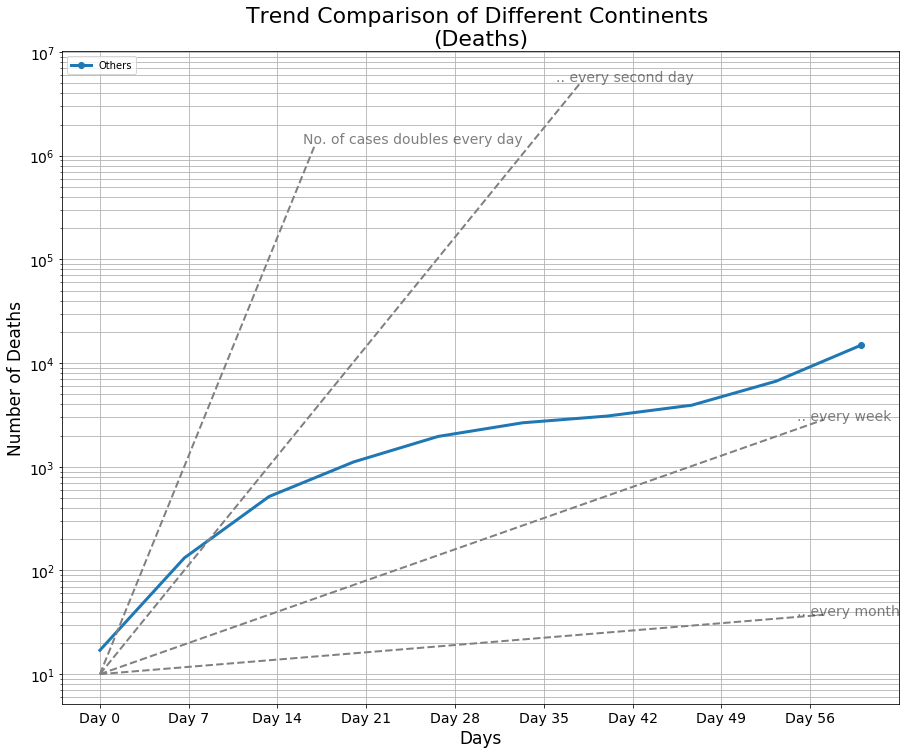

In [62]:
temp = df_deaths.groupby('continent').sum().drop(["Lat","Long"],axis =1).sort_values(df_deaths.columns[-1], ascending= False)

threshold = 10
f = plt.figure(figsize=(15,12))
ax = f.add_subplot(111)
for i,country in enumerate(temp.index):
    if i >= 10:
        break
    days = 61
    t = temp.loc[temp.index== country].values[0]
    t = t[t>threshold][:days]
     
    date = np.arange(0,len(t[:days]))
    xnew = np.linspace(date.min(), date.max(), 10)
    spl = make_interp_spline(date, t, k=1)  # type: BSpline
    power_smooth = spl(xnew)
    plt.plot(xnew,power_smooth,'-o',label = country,linewidth =3, markevery=[-1])


plt.tick_params(labelsize = 14)        
plt.xticks(np.arange(0,days,7),[ "Day "+str(i) for i in range(days)][::7])     

# Reference lines 
x = np.arange(0,18)
y = 2**(x+np.log2(threshold))
plt.plot(x,y,"--",linewidth =2,color = "gray")
plt.annotate("No. of cases doubles every day",(x[-2],y[-1]),xycoords="data",fontsize=14,alpha = 0.5)

x = np.arange(0,days-22)
y = 2**(x/2+np.log2(threshold))
plt.plot(x,y,"--",linewidth =2,color = "gray")
plt.annotate(".. every second day",(x[-3],y[-1]),xycoords="data",fontsize=14,alpha = 0.5)

x = np.arange(0,days-3)
y = 2**(x/7+np.log2(threshold))
plt.plot(x,y,"--",linewidth =2,color = "gray")
plt.annotate(".. every week",(x[-3],y[-1]),xycoords="data",fontsize=14,alpha = 0.5)

x = np.arange(0,days-3)
y = 2**(x/30+np.log2(threshold))
plt.plot(x,y,"--",linewidth =2,color = "gray")
plt.annotate(".. every month",(x[-3],y[-1]),xycoords="data",fontsize=14,alpha = 0.5)

# plot Params
plt.xlabel("Days",fontsize=17)
plt.ylabel("Number of Deaths",fontsize=17)
plt.title("Trend Comparison of Different Continents \n(Deaths)",fontsize=22)
plt.legend(loc = "upper left")
plt.yscale("log")
plt.grid(which="both")
plt.savefig(out+'Trend Comparison continents (deaths).png')
plt.show()

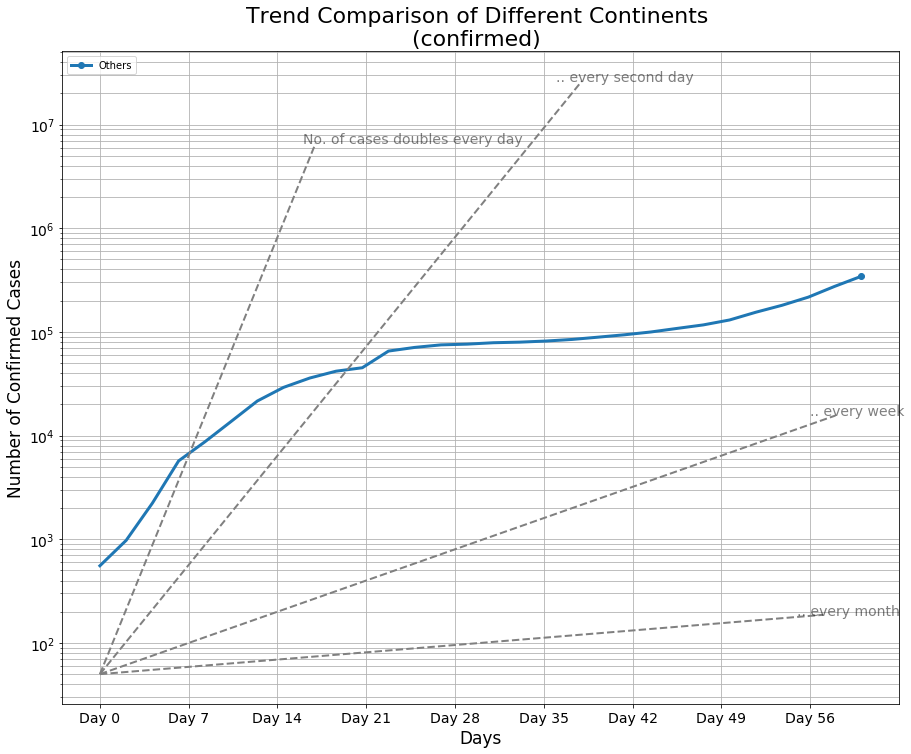

In [63]:
temp = df_confirmed.groupby('continent').sum().drop(["Lat","Long"],axis =1).sort_values(df_confirmed.columns[-1], ascending= False)

threshold = 50
f = plt.figure(figsize=(15,12))
ax = f.add_subplot(111)
for i,country in enumerate(temp.index):
    if i >= 10:
        break
    days = 61
    t = temp.loc[temp.index== country].values[0]
    t = t[t>threshold][:days]
     
    date = np.arange(0,len(t[:days]))
    xnew = np.linspace(date.min(), date.max(), 30)
    spl = make_interp_spline(date, t, k=1)  # type: BSpline
    power_smooth = spl(xnew)
    plt.plot(xnew,power_smooth,'-o',label = country,linewidth =3, markevery=[-1])

plt.tick_params(labelsize = 14)        
plt.xticks(np.arange(0,days,7),[ "Day "+str(i) for i in range(days)][::7])     

# Reference lines 
x = np.arange(0,18)
y = 2**(x+np.log2(threshold))
plt.plot(x,y,"--",linewidth =2,color = "gray")
plt.annotate("No. of cases doubles every day",(x[-2],y[-1]),xycoords="data",fontsize=14,alpha = 0.5)

x = np.arange(0,days-22)
y = 2**(x/2+np.log2(threshold))
plt.plot(x,y,"--",linewidth =2,color = "gray")
plt.annotate(".. every second day",(x[-3],y[-1]),xycoords="data",fontsize=14,alpha = 0.5)

x = np.arange(0,days-2)
y = 2**(x/7+np.log2(threshold))
plt.plot(x,y,"--",linewidth =2,color = "gray")
plt.annotate(".. every week",(x[-3],y[-1]),xycoords="data",fontsize=14,alpha = 0.5)

x = np.arange(0,days-3)
y = 2**(x/30+np.log2(threshold))
plt.plot(x,y,"--",linewidth =2,color = "gray")
plt.annotate(".. every month",(x[-3],y[-1]),xycoords="data",fontsize=14,alpha = 0.5)


# plot Params
plt.xlabel("Days",fontsize=17)
plt.ylabel("Number of Confirmed Cases",fontsize=17)
plt.title("Trend Comparison of Different Continents \n(confirmed) ",fontsize=22)
plt.legend(loc = "upper left")
plt.yscale("log")
plt.grid(which="both")
plt.savefig(out+'Trend Comparison of continents (Confirmed).png')
plt.show()

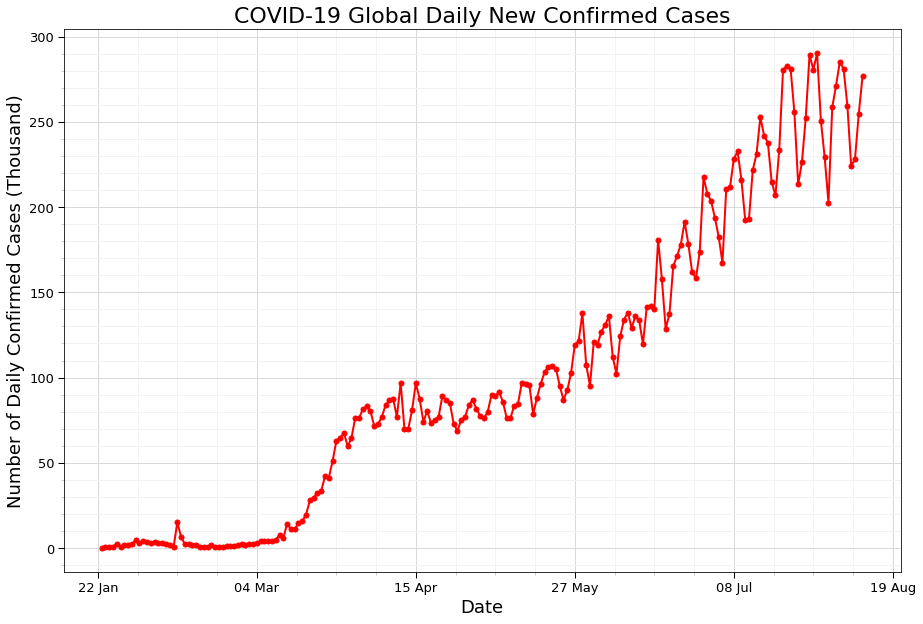

In [64]:
from datetime import datetime, timedelta,date
# Data
def dd(date1,date2):
    return (datetime.strptime(date1,'%m/%d/%y') - datetime.strptime(date2,'%m/%d/%y')).days


out = ""#+"output/"


case_nums_country = df_confirmed.groupby("country").sum().drop(['Lat','Long'],axis =1).apply(lambda x: x[x > 0].count(), axis =0)
d = [datetime.strptime(date,'%m/%d/%y').strftime("%d %b") for date in case_nums_country.index]


thousand = 1000
prediction_days = 10
temp_data = np.nan_to_num(df_confirmed.sum()[5:].diff())


# Plot
f = plt.figure(figsize=(15,10))
ax = f.add_subplot(111)


date = np.arange(0,len(temp_data))

marker_style = dict(linewidth=2, linestyle='-', marker='o',markersize=5)
plt.plot(date,temp_data/thousand,"-.",color="red",**marker_style)


nextdays = [(datetime.strptime(d[-1],'%d %b')+timedelta(days=i)).strftime("%d %b") for i in range(1,prediction_days+1)]
total =d+nextdays

# X-axis
plt.xticks(list(np.arange(0,len(total),int(len(total)/5))),total[:-1:int(len(total)/5)]+[total[-1]])

# Tick-Parameters
ax.xaxis.set_minor_locator(ticker.AutoMinorLocator())
ax.yaxis.set_minor_locator(ticker.AutoMinorLocator())
ax.tick_params(which='both', width=1,labelsize=12)
ax.tick_params(which='major', length=6)
ax.tick_params(which='minor', length=3, color='0.8')

# Grid
plt.grid(lw = 1, ls = '-', c = "0.85", which = 'major')
plt.grid(lw = 1, ls = '-', c = "0.95", which = 'minor')

# Plot Title
plt.title("COVID-19 Global Daily New Confirmed Cases",{'fontsize':22})

# Axis Lable
plt.xlabel("Date",fontsize =18)
plt.ylabel("Number of Daily Confirmed Cases (Thousand)",fontsize =18)

# plt.yscale("log")
plt.tick_params(labelsize = 13) 
plt.savefig(out+"daily confirmed cases global.png")
plt.show() 

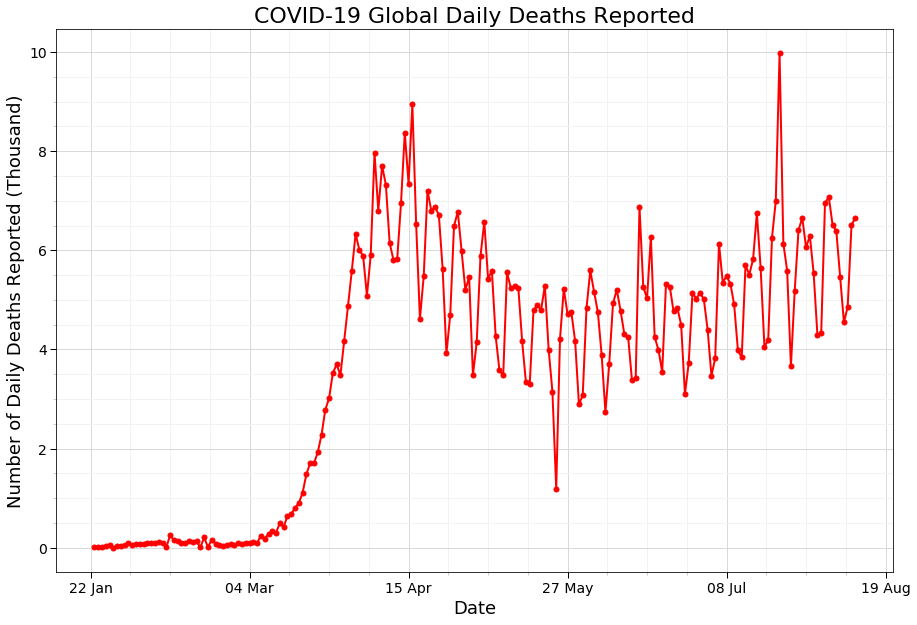

In [65]:
# Data
temp_data = np.nan_to_num(df_deaths.sum()[5:].diff())


# Plot
f = plt.figure(figsize=(15,10))
ax = f.add_subplot(111)


date = np.arange(0,len(temp_data))

marker_style = dict(linewidth=2, linestyle='-', marker='o',markersize=5)
plt.plot(date,temp_data/thousand,"-.",color="red",**marker_style)


nextdays = [(datetime.strptime(d[-1],'%d %b')+timedelta(days=i)).strftime("%d %b") for i in range(1,prediction_days+1)]
total =d+nextdays

# X-axis
plt.xticks(list(np.arange(0,len(total),int(len(total)/5))),total[:-1:int(len(total)/5)]+[total[-1]])

# Tick-Parameters
ax.xaxis.set_minor_locator(ticker.AutoMinorLocator())
ax.yaxis.set_minor_locator(ticker.AutoMinorLocator())
ax.tick_params(which='both', width=1,labelsize=14)
ax.tick_params(which='major', length=6)
ax.tick_params(which='minor', length=3, color='0.8')

# Grid
plt.grid(lw = 1, ls = '-', c = "0.85", which = 'major')
plt.grid(lw = 1, ls = '-', c = "0.95", which = 'minor')

# Plot Title
plt.title("COVID-19 Global Daily Deaths Reported",{'fontsize':22})

# Axis Lable
plt.xlabel("Date",fontsize =18)
plt.ylabel("Number of Daily Deaths Reported (Thousand)",fontsize =18)

# plt.yscale("log")
plt.savefig(out+"daily deaths cases Global.png")
plt.show()

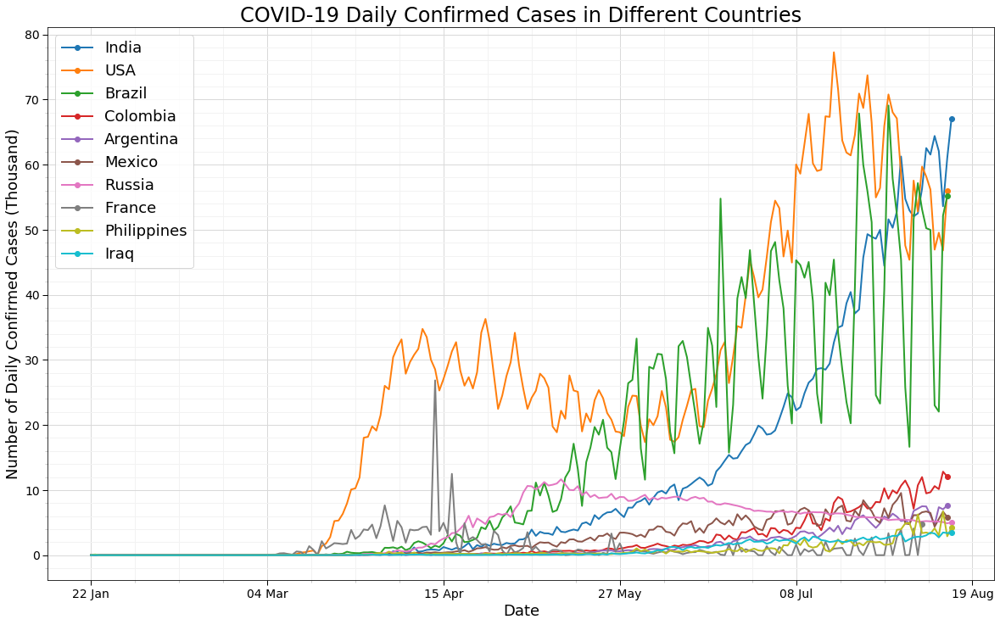

In [66]:
thoudand = 1000
temp = df_confirmed.groupby('country').sum().diff(axis=1).sort_values(df_deaths.columns[-1],ascending =False).head(10).replace(np.nan,0)
threshold = 0
f = plt.figure(figsize=(20,12))
ax = f.add_subplot(111)
for i,country in enumerate(temp.index):
    t = temp.loc[temp.index== country].values[0]
    t = t[t>=threshold]
    
    date = np.arange(0,len(t[:]))
    plt.plot(date,t/thoudand,'-o',label = country,linewidth =2, markevery=[-1])


nextdays = [(datetime.strptime(d[-1],'%d %b')+timedelta(days=i)).strftime("%d %b") for i in range(1,prediction_days+1)]
total =d+nextdays

# X-axis
plt.xticks(list(np.arange(0,len(total),int(len(total)/5))),total[:-1:int(len(total)/5)]+[total[-1]])

# Tick-Parameters
ax.xaxis.set_minor_locator(ticker.AutoMinorLocator())
ax.yaxis.set_minor_locator(ticker.AutoMinorLocator())
ax.tick_params(which='both', width=1,labelsize=14)
ax.tick_params(which='major', length=6)
ax.tick_params(which='minor', length=3, color='0.8')

# Grid
plt.grid(lw = 1, ls = '-', c = "0.85", which = 'major')
plt.grid(lw = 1, ls = '-', c = "0.95", which = 'minor')

# Plot Title
plt.title("COVID-19 Daily Confirmed Cases in Different Countries",{'fontsize':24})

# Axis Lable
plt.xlabel("Date",fontsize =18)
plt.ylabel("Number of Daily Confirmed Cases (Thousand)",fontsize =18)

# plt.yscale("log")
plt.legend(fontsize=18) 
plt.savefig(out+"daily confirmed cases countrywise.png")
plt.show()

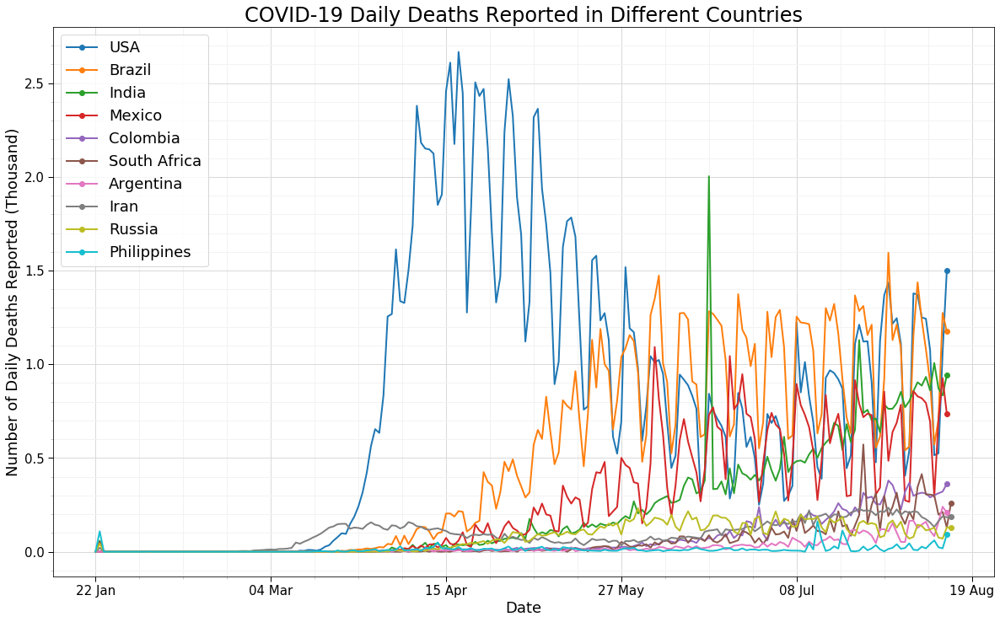

In [67]:
thoudand = 1000
temp = df_deaths.groupby('country').sum().diff(axis=1).sort_values(df_deaths.columns[-1],ascending =False).head(10).replace(np.nan,0)
threshold = 0
f = plt.figure(figsize=(20,12))
ax = f.add_subplot(111)
for i,country in enumerate(temp.index):
    t = temp.loc[temp.index== country].values[0]
    t = t[t>=threshold]
    
    date = np.arange(0,len(t[:]))
    plt.plot(date,t/thoudand,'-o',label = country,linewidth =2, markevery=[-1])


nextdays = [(datetime.strptime(d[-1],'%d %b')+timedelta(days=i)).strftime("%d %b") for i in range(1,prediction_days+1)]
total =d+nextdays

# X-axis
plt.xticks(list(np.arange(0,len(total),int(len(total)/5))),total[:-1:int(len(total)/5)]+[total[-1]])

# Tick-Parameters
ax.xaxis.set_minor_locator(ticker.AutoMinorLocator())
ax.yaxis.set_minor_locator(ticker.AutoMinorLocator())
ax.tick_params(which='both', width=1,labelsize=15)
ax.tick_params(which='major', length=6)
ax.tick_params(which='minor', length=3, color='0.8')

# Grid
plt.grid(lw = 1, ls = '-', c = "0.85", which = 'major')
plt.grid(lw = 1, ls = '-', c = "0.95", which = 'minor')

# Plot Title
plt.title("COVID-19 Daily Deaths Reported in Different Countries",{'fontsize':24})

# Axis Lable
plt.xlabel("Date",fontsize =18)
plt.ylabel("Number of Daily Deaths Reported (Thousand)",fontsize =18)

# plt.yscale("log")
plt.legend(fontsize=18) 
plt.savefig(out+"daily deaths reported countrywise.png")
plt.show()

# COVID-19 Case (Confirmed and Deaths) Percent Split in Different countries (Pie Viz)
These pie plots are showing the proportion of the spread of this Pandemic across the world. Each pie is showing a few major contributor countries, and rest countries are shown as "Others". Criteria : * Confirmed Cases: Any countries reported more than 20000 confirmed cases are shown the rest of the countries are under "others" Category. * Deaths: Any Countries reported more than 1000 deaths are shown rest of the countries are under "others" Category. * Active Cases: Any Countries reported more than 15000 active cases are shown the rest of the countries are under "others" Category. * Recovered Cases: Any Countries reported more than 2000 recoveries are shown rest of the countries are under "others" Category.

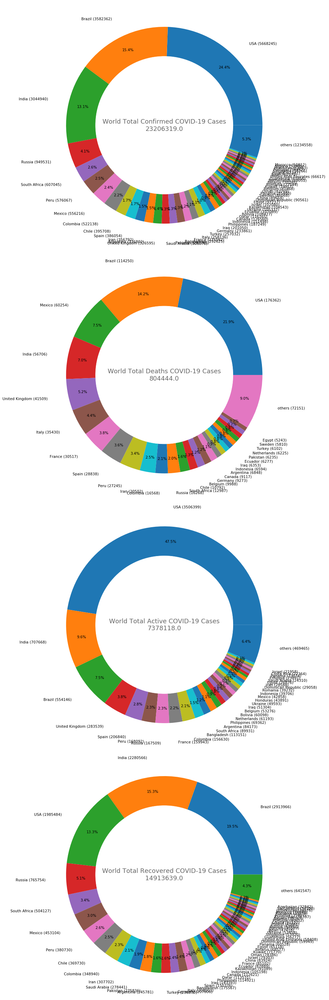

<Figure size 432x288 with 0 Axes>

In [68]:
rows = 4
f = plt.figure(figsize=(15,10*rows))

stats = [df_covid19.loc[:,['country','Confirmed']],df_covid19.loc[:,['country','Deaths']],df_covid19.loc[:,['country','Active']],df_covid19.loc[:,['country','Recovered']]]
label = ["Confirmed","Deaths","Active","Recovered"]
threshold = [50000,5000,20000,30000]
for i, stat in enumerate(stats):
    plt.tight_layout()
    df_countries = stat.groupby(["country"]).sum()
    df_countries = df_countries.sort_values(df_countries.columns[-1],ascending= False)
    others = df_countries[df_countries[df_countries.columns[-1]] < threshold[i] ].sum()[-1]
    df_countries = df_countries[df_countries[df_countries.columns[-1]] > threshold[i]]
    df_countries = df_countries[df_countries.columns[-1]]
    df_countries["others"] = others
    labels = [df_countries.index[i] +" (" + str(int(df_countries[i])) +") "for i in range(df_countries.shape[0])]

    ax = f.add_subplot(rows,1,i+1)
    plt.pie(df_countries, labels=labels,autopct='%1.1f%%',pctdistance=0.85, labeldistance=1.2,textprops = {'fontsize':10.5})
    my_circle=plt.Circle( (0,0), 0.7, color='white')
    p=plt.gcf()
    p.gca().add_artist(my_circle)
    plt.text(0.5,0.5,"World Total "+label[i]+ " COVID-19 Cases\n"+str(stat.sum().values[1]), horizontalalignment='center',verticalalignment='center',transform=ax.transAxes, size=18, alpha = 0.6)


plt.show()
plt.savefig(out+"daily deaths reported countrywise.png")


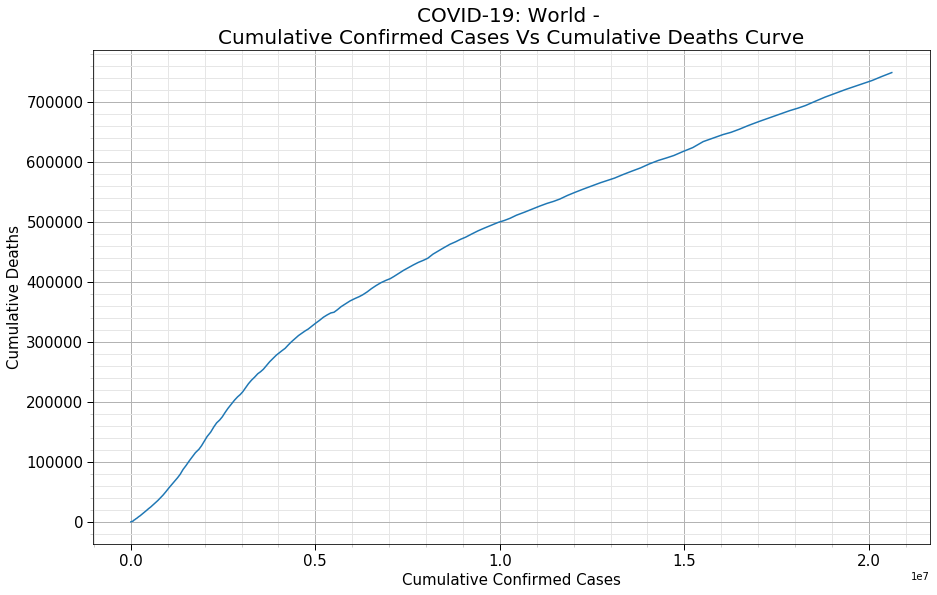

In [69]:
cols =1
rows = 2

f = plt.figure(figsize=(15,10*rows))

# SubPlot 1
ax = f.add_subplot(211)
plt.plot(np.sum(np.asarray(df_confirmed.iloc[:,5:]),axis = 0),np.sum(np.asarray(df_deaths.iloc[:,5:]),axis = 0))

axis_label = ["Cumulative Confirmed Cases","Cumulative Deaths"]
plt_title = "COVID-19: World - \nCumulative Confirmed Cases Vs Cumulative Deaths Curve"
plot_params(ax,axis_label,plt_title)


# # SubPlot 2
# ax = f.add_subplot(212)
# mortality_rate = get_mortality_rate(df_confirmed,df_deaths,continent=continents[0])
# plt.plot(np.sum(np.asarray(df_recovered.iloc[:,5:]),axis = 0),np.sum(np.asarray(df_deaths.iloc[:,5:]),axis = 0))

# axis_label = ["Cumulative Recoveries","Cumulative Deaths"]
# plt_title = "COVID-19: World - Cumulative Recovery Vs Cumulative Deaths Curve"

# plot_params(ax,axis_label,plt_title)
plt.minorticks_on()
plt.savefig(out+'Cumulative Confirmed Cases Vs Cumulative Deaths Curve.png')
plt.show()

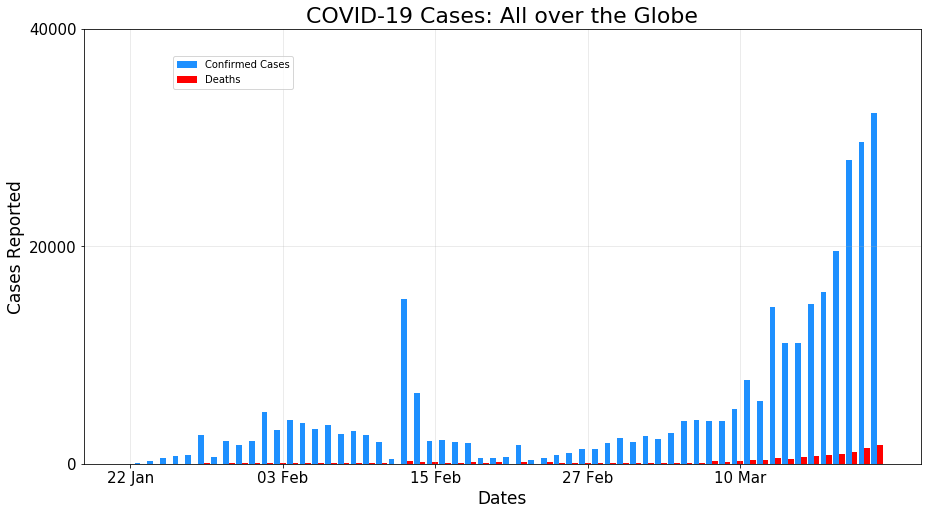

In [70]:
df_confirmed_report = df_confirmed.iloc[:,:65].copy()
df_confirmed_report.loc[df_confirmed_report['country'] != "China","country"] = "Outside China"
df_confirmed_report = df_confirmed_report.groupby("country").sum().drop(["Lat","Long"],axis =1)
df_confirmed_report.loc["Total"] = df_confirmed_report.sum()
df_confirmed_newcases = df_confirmed_report.groupby(level =0).diff(axis =1)
df_confirmed_newcases = df_confirmed_newcases.replace(np.nan, 0, regex=True) 
df_deaths_report = df_deaths.iloc[:,:65].copy()
df_deaths_report.loc[df_deaths_report['country'] != "China","country"] = "Outside China"
df_deaths_report = df_deaths_report.groupby("country").sum().drop(["Lat","Long"],axis =1)
df_deaths_report.loc["Total"] = df_deaths_report.sum()
df_deaths_newcases = df_deaths_report.groupby(level =0).diff(axis =1)
df_deaths_newcases = df_deaths_newcases.replace(np.nan, 0, regex=True)

f = plt.figure(figsize=(15,8))
ax = f.add_subplot(111)

ax.bar(0.05+np.arange(len(df_confirmed_newcases[df_confirmed_newcases.index == "Total"].columns)),df_confirmed_newcases[df_confirmed_newcases.index == "Total"].values[0], label = "Confirmed Cases",color='dodgerblue',width = 0.45)
ax.bar(0.5+np.arange(len(df_deaths_newcases[df_deaths_newcases.index == "Total"].columns)),df_deaths_newcases[df_deaths_newcases.index == "Total"].values[0], label = "Deaths",color='red',width = 0.45)
# ax.bar(0.67+np.arange(len(df_recovered_newcases[df_recovered_newcases.index == "Total"].columns)),df_recovered_newcases[df_recovered_newcases.index == "Total"].values[0], label = "Recoveries",color='orange',width = 0.33)

# ax.bar(df_recovered_report[df_recovered_report.index == "Outside China"].columns,df_newcases[df_newcases.index == "Outside China"].values[0],bottom=df_newcases[df_newcases.index == "China"].values[0],label = "Outside China (New)",color='orangered')

# Labels
ax.set_xlabel("Dates",fontsize=17)
ax.set_ylabel("Cases Reported",fontsize =17)

ax.tick_params(labelsize=15)
length = len(df_confirmed_newcases.columns)
ax.set_xticks(np.arange(0.5, length, int(length/5)))
ax.set_xticklabels([datetime.strptime(date,'%m/%d/%y').strftime("%d %b") for date in df_confirmed_report.columns][::int(length/5)],fontsize=15)
ax.set_yticks(np.arange(0, df_confirmed_newcases.loc["Total"].max()+10000, 20000))
ax.legend(loc = "upper left", bbox_to_anchor=(0.1,0.95))
plt.title("COVID-19 Cases: All over the Globe",fontsize = 22)
plt.grid(alpha = 0.3)
plt.savefig(out+'China vs Rest of the world5.png')
plt.show()

In [71]:
import json, requests
india_data_json = requests.get('https://api.rootnet.in/covid19-in/unofficial/covid19india.org/statewise').json()
df_india = pd.io.json.json_normalize(india_data_json['data']['statewise'])
df_india = df_india.set_index("state")

# COVID-19 : INDIA

In [72]:
total = df_india.sum()
total.name = "Total"
df_t = pd.DataFrame(total,dtype=float).transpose()
df_t["Mortality Rate (per 100)"] = np.round(100*df_t["deaths"]/df_t["confirmed"],2)
df_t.style.background_gradient(cmap='Purples',axis=1)

,confirmed,recovered,deaths,active,Mortality Rate (per 100)
Total,3384575.000000,2583063.000000,61694.000000,739248.000000,1.820000


In [73]:
df_india["Mortality Rate (per 100)"]= np.round(np.nan_to_num(100*df_india["deaths"]/df_india["confirmed"]),2)
df_india.style.background_gradient(cmap='Blues',subset=["confirmed"])\
                        .background_gradient(cmap='Reds',subset=["deaths"])\
                        .background_gradient(cmap='Greens',subset=["recovered"])\
                        .background_gradient(cmap='Purples',subset=["active"])\
                        .background_gradient(cmap='YlOrBr',subset=["Mortality Rate (per 100)"])\
                        .format("{:.2f}",subset=["Mortality Rate (per 100)"])

,confirmed,recovered,deaths,active,Mortality Rate (per 100)
state,,,,,
Maharashtra,733568,531563,23444,178234,3.20
Tamil Nadu,403242,343930,6948,52364,1.72
Andhra Pradesh,393090,295248,3633,94209,0.92
Karnataka,309792,219554,5232,84987,1.69
Delhi,167604,150027,4369,13208,2.61
Uttar Pradesh,208419,152893,3217,52309,1.54
West Bengal,150772,121046,3017,26709,2.00
Bihar,128850,109696,662,18491,0.51
Telangana,114483,86095,788,27600,0.69


In [74]:
df_india[df_india['deaths'] > 0].style.background_gradient(cmap='Blues',subset=["confirmed"])\
                        .background_gradient(cmap='Reds',subset=["deaths"])\
                        .background_gradient(cmap='Greens',subset=["recovered"])\
                        .background_gradient(cmap='Purples',subset=["active"])\
                        .background_gradient(cmap='YlOrBr',subset=["Mortality Rate (per 100)"])\
                        .format("{:.2f}",subset=["Mortality Rate (per 100)"])


,confirmed,recovered,deaths,active,Mortality Rate (per 100)
state,,,,,
Maharashtra,733568,531563,23444,178234,3.20
Tamil Nadu,403242,343930,6948,52364,1.72
Andhra Pradesh,393090,295248,3633,94209,0.92
Karnataka,309792,219554,5232,84987,1.69
Delhi,167604,150027,4369,13208,2.61
Uttar Pradesh,208419,152893,3217,52309,1.54
West Bengal,150772,121046,3017,26709,2.00
Bihar,128850,109696,662,18491,0.51
Telangana,114483,86095,788,27600,0.69


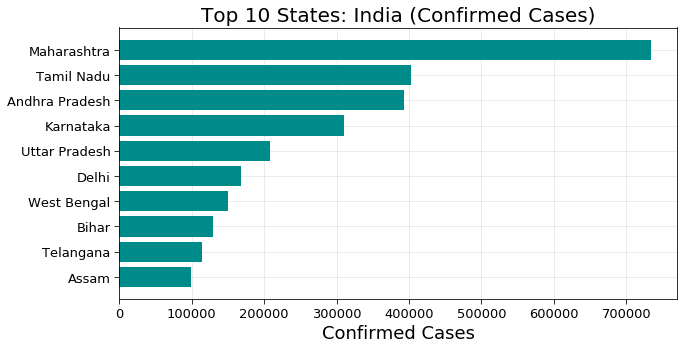

In [75]:
f = plt.figure(figsize=(10,5))
f.add_subplot(111)

plt.axes(axisbelow=True)
plt.barh(df_india.sort_values('confirmed')["confirmed"].index[-10:],df_india.sort_values('confirmed')["confirmed"].values[-10:],color="darkcyan")
plt.tick_params(size=5,labelsize = 13)
plt.xlabel("Confirmed Cases",fontsize=18)
plt.title("Top 10 States: India (Confirmed Cases)",fontsize=20)
plt.grid(alpha=0.3)
plt.savefig(out+'Top 10 States_India (Confirmed Cases).png')

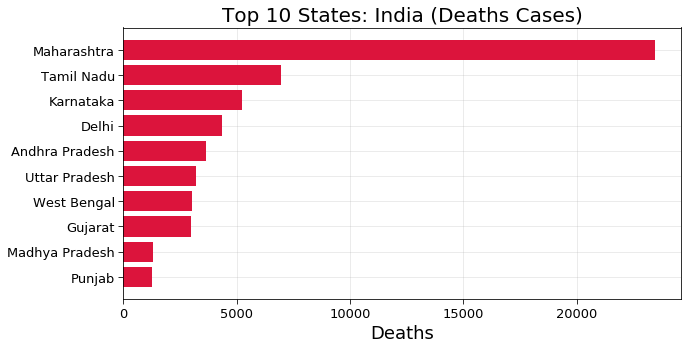

In [76]:
f = plt.figure(figsize=(10,5))
f.add_subplot(111)

plt.axes(axisbelow=True)
plt.barh(df_india.sort_values('deaths')["deaths"].index[-10:],df_india.sort_values('deaths')["deaths"].values[-10:],color="crimson")
plt.tick_params(size=5,labelsize = 13)
plt.xlabel("Deaths",fontsize=18)
plt.title("Top 10 States: India (Deaths Cases)",fontsize=20)
plt.grid(alpha=0.3)
plt.savefig(out+'Top 10 States_India (Deaths Cases).png')

In [77]:
df_india.corr().style.background_gradient(cmap='Reds').format("{:.2f}")

,confirmed,recovered,deaths,active,Mortality Rate (per 100)
confirmed,1.00,1.00,0.92,0.97,0.50
recovered,1.00,1.00,0.90,0.94,0.51
deaths,0.92,0.90,1.00,0.90,0.58
active,0.97,0.94,0.90,1.00,0.46
Mortality Rate (per 100),0.50,0.51,0.58,0.46,1.00


In [78]:
# Adding Location data (Latitude,Longitude)
locations = {
    "Kerala" : [10.8505,76.2711],
    "Maharashtra" : [19.7515,75.7139],
    "Karnataka": [15.3173,75.7139],
    "Telangana": [18.1124,79.0193],
    "Uttar Pradesh": [26.8467,80.9462],
    "Rajasthan": [27.0238,74.2179],
    "Gujarat":[22.2587,71.1924],
    "Delhi" : [28.7041,77.1025],
    "Punjab":[31.1471,75.3412],
    "Tamil Nadu": [11.1271,78.6569],
    "Haryana": [29.0588,76.0856],
    "Madhya Pradesh":[22.9734,78.6569],
    "Jammu and Kashmir":[33.7782,76.5762],
    "Ladakh": [34.1526,77.5770],
    "Andhra Pradesh":[15.9129,79.7400],
    "West Bengal": [22.9868,87.8550],
    "Bihar": [25.0961,85.3131],
    "Chhattisgarh":[21.2787,81.8661],
    "Chandigarh":[30.7333,76.7794],
    "Uttarakhand":[30.0668,79.0193],
    "Himachal Pradesh":[31.1048,77.1734],
    "Goa": [15.2993,74.1240],
    "Odisha":[20.9517,85.0985],
    "Andaman and Nicobar Islands": [11.7401,92.6586],
    "Puducherry":[11.9416,79.8083],
    "Manipur":[24.6637,93.9063],
    "Mizoram":[23.1645,92.9376],
    "Assam":[26.2006,92.9376],
    "Meghalaya":[25.4670,91.3662],
    "Tripura":[23.9408,91.9882],
    "Arunachal Pradesh":[28.2180,94.7278],
    "Jharkhand" : [23.6102,85.2799],
    "Nagaland": [26.1584,94.5624],
    "Sikkim": [27.5330,88.5122],
    "Dadra and Nagar Haveli":[20.1809,73.0169],
    "Lakshadweep":[10.5667,72.6417],
    "Daman and Diu":[20.4283,72.8397]    
}
df_india["Lat"] = ""
df_india["Long"] = ""

for index in df_india.index :
    if index in locations:
        df_india.loc[df_india.index == index,"Lat"] = locations[index][0]
        df_india.loc[df_india.index == index,"Long"] = locations[index][1]
    else:
        df_india.drop([index],inplace=True)

In [79]:
import folium
india = folium.Map(location=[23,80], zoom_start=4,max_zoom=6,min_zoom=4,height=500,width="80%")
for i in range(0,len(df_india[df_india['confirmed']>0].index)):
    folium.Circle(
        location=[df_india.iloc[i]['Lat'], df_india.iloc[i]['Long']],
        tooltip = "<h5 style='text-align:center;font-weight: bold'>"+df_india.iloc[i].name+"</h5>"+
                    "<hr style='margin:10px;'>"+
                    "<ul style='color: #444;list-style-type:circle;align-item:left;padding-left:20px;padding-right:20px'>"+
        "<li>Confirmed: "+str(df_india.iloc[i]['confirmed'])+"</li>"+
        "<li>Active:   "+str(df_india.iloc[i]['active'])+"</li>"+
        "<li>Recovered:   "+str(df_india.iloc[i]['recovered'])+"</li>"+
        "<li>Deaths:   "+str(df_india.iloc[i]['deaths'])+"</li>"+
        
        "<li>Mortality Rate:   "+str(np.round(df_india.iloc[i]['Mortality Rate (per 100)'],2))+"</li>"+
        "</ul>"
        ,
        radius=(int(np.log2(df_india.iloc[i]['confirmed']+1)))*15000,
        color='#ff6600',
        fill_color='#ff8533',
        fill=True).add_to(india)

india
plt.savefig(out+'India (map Cases).png')


<Figure size 432x288 with 0 Axes>

In [80]:
date_usa = datetime.strptime(df_confirmed.columns[-1],'%m/%d/%y').strftime("%m-%d-%Y")
df_temp = pd.read_csv("https://raw.githubusercontent.com/CSSEGISandData/COVID-19/master/csse_covid_19_data/csse_covid_19_daily_reports/"+date_usa+".csv")
df_usa = df_temp.loc[df_temp["Country_Region"]== "US"]
df_usa = df_usa.rename(columns={"Admin2":"County"})

In [81]:
total = df_usa.sum()
total.name = "Total"
pd.DataFrame(total).transpose().loc[:,["Confirmed","Deaths"]].style.background_gradient(cmap='Purples',axis=1)

,Confirmed,Deaths
Total,5197411,166034


In [82]:
df_usa.loc[:,["Confirmed","Deaths","Province_State"]].groupby(["Province_State"]).sum().sort_values("Confirmed",ascending=False).style.background_gradient(cmap='Blues',subset=["Confirmed"]).background_gradient(cmap='Reds',subset=["Deaths"])

,Confirmed,Deaths
Province_State,,
California,591376,10753
Florida,550901,8765
Texas,523977,9527
New York,422703,32797
Georgia,226153,4456
Illinois,199893,7881
Arizona,189443,4347
New Jersey,185938,15885
North Carolina,139739,2280


In [83]:
df_usa.loc[:,["Province_State","Confirmed","Deaths","County"]].sort_values("Confirmed",ascending=False).set_index("County")[:10].style.background_gradient(cmap='Blues',subset=["Confirmed"])\
                        .background_gradient(cmap='Reds',subset=["Deaths"])

,Province_State,Confirmed,Deaths
County,,,
New York City,New York,228729,23602
Los Angeles,California,214283,5112
Miami-Dade,Florida,139271,1939
Maricopa,Arizona,127188,2493
Cook,Illinois,113044,4934
Harris,Texas,88494,1679
Broward,Florida,64080,859
Dallas,Texas,55787,794
Clark,Nevada,50081,842


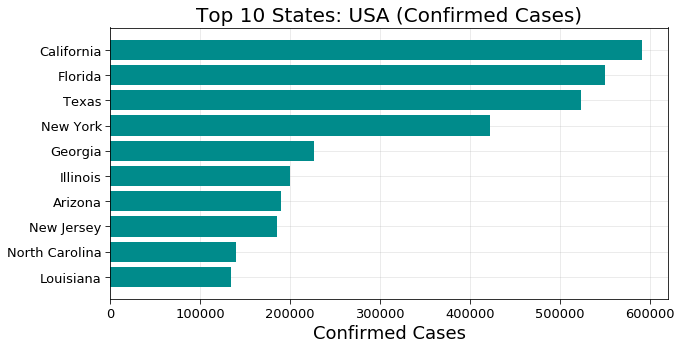

In [84]:
f = plt.figure(figsize=(10,5))
f.add_subplot(111)

plt.axes(axisbelow=True)
plt.barh(df_usa.groupby(["Province_State"]).sum().sort_values('Confirmed')["Confirmed"].index[-10:],df_usa.groupby(["Province_State"]).sum().sort_values('Confirmed')["Confirmed"].values[-10:],color="darkcyan")
plt.tick_params(size=5,labelsize = 13)
plt.xlabel("Confirmed Cases",fontsize=18)
plt.title("Top 10 States: USA (Confirmed Cases)",fontsize=20)
plt.grid(alpha=0.3)
plt.savefig(out+'Top 10 States_USA (Confirmed Cases).png')

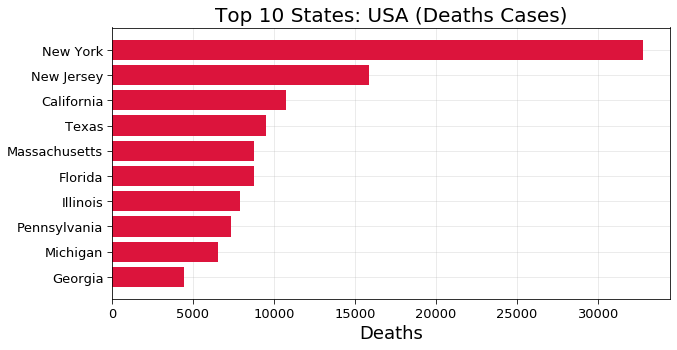

In [85]:
f = plt.figure(figsize=(10,5))
f.add_subplot(111)

plt.axes(axisbelow=True)
plt.barh(df_usa.groupby(["Province_State"]).sum().sort_values('Deaths')["Deaths"].index[-10:],df_usa.groupby(["Province_State"]).sum().sort_values('Deaths')["Deaths"].values[-10:],color="crimson")
plt.tick_params(size=5,labelsize = 13)
plt.xlabel("Deaths",fontsize=18)
plt.title("Top 10 States: USA (Deaths Cases)",fontsize=20)
plt.grid(alpha=0.3)
plt.savefig(out+'Top 10 States_USA (Deaths Cases).png')

# Data Visualization

#### Line Plots

Checking the clusters

#### Line plot with Date and ConfirmedCases

In [86]:
for i in data.cluster.unique()[:5]:
    test_df2= data[["Country_Region","Date","ConfirmedCases","cluster"]]
    test_df2=test_df2[ (test_df2.cluster==i) & (test_df2.Date > "2020-03-02") ]
    fig = px.line(test_df2, x="Date", y="ConfirmedCases", color='Country_Region')
    fig.show()

In [87]:
for i in data.cluster.unique()[:5]:
    test_df2= data[["Country_Region","Date","Fatalities","cluster"]]
    test_df2=test_df2[ (test_df2.cluster==i) & (test_df2.Date > "2020-03-02") ]
    fig = px.line(test_df2, x="Date", y="Fatalities", color='Country_Region')
    fig.show()

#### Investigating the clusters

In [88]:
m_cluster=data[data.Country_Region == "Morocco"].cluster.unique()[0]
test_df2=data[ (data.cluster==m_cluster) & (data.Date > "2020-03-05") ]
fig = px.line(test_df2, x="Date", y="Fatalities", color='Country_Region')

for i in test_df2.Country_Region.unique():
    x=test_df2[test_df2.Country_Region == i].Lockdown_Date.unique()[0]
    y=test_df2[(test_df2.Date == x) & (test_df2.Country_Region == i)].Fatalities.values

    if (x is not np.NAN) & (len(y) >0) :
        fig.add_trace(go.Scatter(x=[x], y=[int(y)],
                        mode='markers',
                        name=i+'-lockdown-'+test_df2[test_df2.Country_Region == i].Lockdown_Type.unique()[0],
                        marker_symbol="x",
                        hoverinfo = 'text',
                        text=i+" Country lockdown Date "+ x,
                        marker = dict(
                                 size=15,
                                 color="black"
                             ),

                        ))

fig.show()

In [89]:
m_cluster=data[data.Country_Region == "Spain"].cluster.unique()[0]
test_df2=data[ (data.cluster==m_cluster) & (data.Date > "2020-03-05") ]
fig = px.line(test_df2, x="Date", y="Fatalities", color='Country_Region')

for i in test_df2.Country_Region.unique():
    x=test_df2[test_df2.Country_Region == i].Lockdown_Date.unique()[0]
    y=test_df2[(test_df2.Date == x) & (test_df2.Country_Region == i)].Fatalities.values

    if (x is not np.NAN) & (len(y) >0) :
        fig.add_trace(go.Scatter(x=[x], y=[int(y)],
                        mode='markers',
                        name=i+'-lockdown-'+test_df2[test_df2.Country_Region == i].Lockdown_Type.unique()[0],
                        marker_symbol="x",
                        hoverinfo = 'text',
                        text=i+" Country lockdown Date "+ x,
                        marker = dict(
                                 size=15,
                                 color="black"
                             ),

                        ))

fig.show()

# Maps

## Fatalities_rate

In [90]:
temp =data[(data.Date == max(data.Date))]

In [91]:
m = folium.Map(location=[0, 0], tiles='cartodbpositron',
               min_zoom=1, max_zoom=10, zoom_start=1.5)


for i in range(0, len(temp)):
    folium.Circle(
        location=[temp.iloc[i]['Latitude'], temp.iloc[i]['Longtitude']],
        color='crimson', fill='crimson',
        tooltip =   '<li><bold>Country : '+str(temp.iloc[i]['Country_Region'])+
                    '<li><bold>Confirmed : '+str(temp.iloc[i]['ConfirmedCases'])+
                    '<li><bold>Death_rate : '+str(temp.iloc[i]['Fatalities_rate'])+
                    '<li><bold>Deaths : '+str(temp.iloc[i]['Fatalities'])+
                    '<li><bold>lockdown date : '+str(temp.iloc[i]['Lockdown_Date'])+
                    '<li><bold>first case date : '+str(temp.iloc[i]['Date_FirstConfirmedCase'])+
                    '<li><bold>mean age : '+str(temp.iloc[i]['Mean_Age'])
        ,
        radius=int(temp.iloc[i]['Fatalities_rate']*10000)).add_to(m)

m


## Mean_Age

In [92]:
m = folium.Map(location=[0, 0], tiles='cartodbpositron',
               min_zoom=1, max_zoom=10, zoom_start=1.5)


for i in range(0, len(temp)):
    folium.Circle(
        location=[temp.iloc[i]['Latitude'], temp.iloc[i]['Longtitude']],
        color='green', fill='green',
        tooltip =   '<li><bold>Country : '+str(temp.iloc[i]['Country_Region'])+
                    '<li><bold>Confirmed : '+str(temp.iloc[i]['ConfirmedCases'])+
                    '<li><bold>Death_rate : '+str(temp.iloc[i]['Fatalities_rate'])+
                    '<li><bold>Deaths : '+str(temp.iloc[i]['Fatalities'])+
                    '<li><bold>lockdown date : '+str(temp.iloc[i]['Lockdown_Date'])+
                    '<li><bold>first case date : '+str(temp.iloc[i]['Date_FirstConfirmedCase'])+
                    '<li><bold>mean age : '+str(temp.iloc[i]['Mean_Age'])
        ,
        radius=int(temp.iloc[i]['Mean_Age']*2500)).add_to(m)

## Fatalities_rate and Mean_Age

In [93]:
m = folium.Map(location=[0, 0], tiles='cartodbpositron',
               min_zoom=1, max_zoom=8, zoom_start=1.5)

m.choropleth(geo_data=country_geo, data=temp,
             columns=['Country_Code', 'Mean_Age'],
             key_on='feature.id',
             # 'BuGn', 'BuPu', 'GnBu', 'OrRd', 'PuBu', 'PuBuGn', 'PuRd', 'RdPu','YlGn', 'YlGnBu', 'YlOrBr', and 'YlOrRd'.
             fill_color='RdPu', fill_opacity=0.7, line_opacity=0.1,
             legend_name="Mean_Age")

for i in range(0, len(temp)):
    folium.Circle(
        location=[temp.iloc[i]['Latitude'], temp.iloc[i]['Longtitude']],
        color='crimson', fill='crimson',
        tooltip =   '<li><bold>Country : '+str(temp.iloc[i]['Country_Region'])+
                    '<li><bold>Confirmed : '+str(temp.iloc[i]['ConfirmedCases'])+
                    '<li><bold>Death_rate : '+str(temp.iloc[i]['Fatalities_rate'])+
                    '<li><bold>Deaths : '+str(temp.iloc[i]['Fatalities'])+
                    '<li><bold>lockdown date : '+str(temp.iloc[i]['Lockdown_Date'])+
                    '<li><bold>first case date : '+str(temp.iloc[i]['Date_FirstConfirmedCase'])+
                    '<li><bold>mean age : '+str(temp.iloc[i]['Mean_Age'])
        ,
        radius=int(temp.iloc[i]['Fatalities_rate']*10000)).add_to(m)

m


In [94]:
m = folium.Map(location=[0, 0], tiles='cartodbpositron',
               min_zoom=1, max_zoom=10, zoom_start=1.5)

m.choropleth(geo_data=country_geo, data=temp,
             columns=['Country_Code', 'Tourism'],
             key_on='feature.id',
             # 'BuGn', 'BuPu', 'GnBu', 'OrRd', 'PuBu', 'PuBuGn', 'PuRd', 'RdPu','YlGn', 'YlGnBu', 'YlOrBr', and 'YlOrRd'.
             fill_color='RdPu', fill_opacity=0.7, line_opacity=0.1,
             legend_name="Tourism",
             threshold_scale=[14000.0,5000000, 20000000.0, 40000000.0, 60000000.0, 89322000.0]
             )

for i in range(0, len(temp)):
    folium.Circle(
        location=[temp.iloc[i]['Latitude'], temp.iloc[i]['Longtitude']],
        color='crimson', fill='crimson',
        tooltip =   '<li><bold>Country : '+str(temp.iloc[i]['Country_Region'])+
                    '<li><bold>Confirmed : '+str(temp.iloc[i]['ConfirmedCases'])+
                    '<li><bold>Death_rate : '+str(round(temp.iloc[i]['Fatalities_rate'],2))+
                    '<li><bold>Deaths : '+str(temp.iloc[i]['Fatalities'])+
                    '<li><bold>lockdown date : '+str(temp.iloc[i]['Lockdown_Date'])+
                    '<li><bold>first case date : '+str(temp.iloc[i]['Date_FirstConfirmedCase'])+
                    '<li><bold>mean age : '+str(temp.iloc[i]['Mean_Age'])+
                    '<li><bold>Tourism : '+str(temp.iloc[i]['Tourism'])
        ,
        radius=int(temp.iloc[i]['Fatalities_rate']*10000)).add_to(m)

m

## The Human Freedom Index

In [95]:
temp.pf_score = temp.pf_score.astype("float")
temp.hf_score = temp.hf_score.astype("float")

In [96]:
m = folium.Map(location=[0, 0], tiles='cartodbpositron',
               min_zoom=1, max_zoom=8, zoom_start=1.5)

m.choropleth(geo_data=country_geo, data=temp,
             columns=['Country_Code', 'pf_score'],
             key_on='feature.id',
             # 'BuGn', 'BuPu', 'GnBu', 'OrRd', 'PuBu', 'PuBuGn', 'PuRd', 'RdPu','YlGn', 'YlGnBu', 'YlOrBr', and 'YlOrRd'.
             fill_color='RdPu', fill_opacity=0.7, line_opacity=0.1,
             legend_name="pf_score",
             )

for i in range(0, len(temp)):
    folium.Circle(
        location=[temp.iloc[i]['Latitude'], temp.iloc[i]['Longtitude']],
        color='crimson', fill='crimson',
        tooltip =   '<li><bold>Country : '+str(temp.iloc[i]['Country_Region'])+
                    '<li><bold>Confirmed : '+str(temp.iloc[i]['ConfirmedCases'])+
                    '<li><bold>Death_rate : '+str(temp.iloc[i]['Fatalities_rate'])+
                    '<li><bold>Deaths : '+str(temp.iloc[i]['Fatalities'])+
                    '<li><bold>lockdown date : '+str(temp.iloc[i]['Lockdown_Date'])+
                    '<li><bold>first case date : '+str(temp.iloc[i]['Date_FirstConfirmedCase'])+
                    '<li><bold>mean age : '+str(temp.iloc[i]['Mean_Age'])
        ,
        radius=int(temp.iloc[i]['Fatalities_rate']*10000)).add_to(m)

m

In [97]:
m = folium.Map(location=[0, 0], tiles='cartodbpositron',
               min_zoom=1, max_zoom=8, zoom_start=1.5)

m.choropleth(geo_data=country_geo, data=temp,
             columns=['Country_Code', 'hf_score'],
             key_on='feature.id',
             # 'BuGn', 'BuPu', 'GnBu', 'OrRd', 'PuBu', 'PuBuGn', 'PuRd', 'RdPu','YlGn', 'YlGnBu', 'YlOrBr', and 'YlOrRd'.
             fill_color='RdPu', fill_opacity=0.7, line_opacity=0.1,
             legend_name="hf_score")

for i in range(0, len(temp)):
    folium.Circle(
        location=[temp.iloc[i]['Latitude'], temp.iloc[i]['Longtitude']],
        color='crimson', fill='crimson',
        tooltip =   '<li><bold>Country : '+str(temp.iloc[i]['Country_Region'])+
                    '<li><bold>Confirmed : '+str(temp.iloc[i]['ConfirmedCases'])+
                    '<li><bold>Death_rate : '+str(temp.iloc[i]['Fatalities_rate'])+
                    '<li><bold>Deaths : '+str(temp.iloc[i]['Fatalities'])+
                    '<li><bold>lockdown date : '+str(temp.iloc[i]['Lockdown_Date'])+
                    '<li><bold>first case date : '+str(temp.iloc[i]['Date_FirstConfirmedCase'])+
                    '<li><bold>mean age : '+str(temp.iloc[i]['Mean_Age'])
        ,
        radius=int(temp.iloc[i]['Fatalities_rate']*10000)).add_to(m)

m

## Number of tests per day by country

In [98]:
temp.daily_tested = temp.daily_tested.astype("float")

In [99]:
m = folium.Map(location=[0, 0], tiles='cartodbpositron',
               min_zoom=1, max_zoom=8, zoom_start=1.5)

m.choropleth(geo_data=country_geo, data=temp,
             columns=['Country_Code', 'daily_tested'],
             key_on='feature.id',
             # 'BuGn', 'BuPu', 'GnBu', 'OrRd', 'PuBu', 'PuBuGn', 'PuRd', 'RdPu','YlGn', 'YlGnBu', 'YlOrBr', and 'YlOrRd'.
             fill_color='RdPu', fill_opacity=0.7, line_opacity=0.1,
             legend_name="daily_tested" )
           
for i in range(0, len(temp)):
    folium.Circle(
        location=[temp.iloc[i]['Latitude'], temp.iloc[i]['Longtitude']],
        color='crimson', fill='crimson',
        tooltip =       '<li><bold>Country : '+str(temp.iloc[i]['Country_Region'])+
                        '<li><bold>Confirmed : '+str(temp.iloc[i]['ConfirmedCases'])+
                        '<li><bold>Death_rate : '+str(temp.iloc[i]['Fatalities_rate'])+
                        '<li><bold>Deaths : '+str(temp.iloc[i]['Fatalities'])+
                        '<li><bold>lockdown date : '+str(temp.iloc[i]['Lockdown_Date'])+
                        '<li><bold>first case date : '+str(temp.iloc[i]['Date_FirstConfirmedCase'])+
                        '<li><bold>mean age : '+str(temp.iloc[i]['Mean_Age']),
        
        radius=int(temp.iloc[i]['ConfirmedCases']*1.1)).add_to(m)
m



In [100]:
temp.to_csv("temp.csv",index=False)

## Fatalities_rate and the difference between lockDown Date and FirstConfirmedCase


In [101]:
temp.diff_FC_LD.replace({np.NAN:"62"},inplace=True)
temp.diff_FF_LD.replace({np.NAN:"42"},inplace=True)
temp.diff_FC_LD=temp.diff_FC_LD.astype(str)
temp.diff_FF_LD=temp.diff_FF_LD.astype(str)
temp.diff_FC_LD=temp.diff_FC_LD.str[:2]
temp.diff_FF_LD=temp.diff_FF_LD.str[:2]
temp.diff_FC_LD = temp.diff_FC_LD.astype(int)
temp.diff_FF_LD = temp.diff_FF_LD.astype(int)

In [102]:
m = folium.Map(location=[0, 0], tiles='cartodbpositron',
               min_zoom=1, max_zoom=10, zoom_start=1.5)

m.choropleth(geo_data=country_geo, data=temp,
             columns=['Country_Code', 'diff_FC_LD'],
             key_on='feature.id',
             # 'BuGn', 'BuPu', 'GnBu', 'OrRd', 'PuBu', 'PuBuGn', 'PuRd', 'RdPu','YlGn', 'YlGnBu', 'YlOrBr', and 'YlOrRd'.
             fill_color='RdPu', fill_opacity=0.7, line_opacity=0.1,
             legend_name="FirstCaseConfirmed_diff_lockdown"
             )

for i in range(0, len(temp)):
    folium.Circle(
        location=[temp.iloc[i]['Latitude'], temp.iloc[i]['Longtitude']],
        color='crimson', fill='crimson',
        tooltip =   '<li><bold>Country : '+str(temp.iloc[i]['Country_Region'])+
                    '<li><bold>Confirmed : '+str(temp.iloc[i]['ConfirmedCases'])+
                    '<li><bold>Death_rate : '+str(round(temp.iloc[i]['Fatalities_rate'],2))+
                    '<li><bold>Deaths : '+str(temp.iloc[i]['Fatalities'])+
                    '<li><bold>lockdown date : '+str(temp.iloc[i]['Lockdown_Date'])+
                    '<li><bold>first case date : '+str(temp.iloc[i]['Date_FirstConfirmedCase'])+
                    '<li><bold>mean age : '+str(temp.iloc[i]['Mean_Age'])+
                    '<li><bold>Tourism : '+str(temp.iloc[i]['Tourism'])
        ,
        radius=int(temp.iloc[i]['Fatalities_rate']*10000)).add_to(m)

m

# Feature Importance

# Correlation

In [103]:
data.pf_score = data.pf_score.astype("float")
data.hf_score = data.hf_score.astype("float")

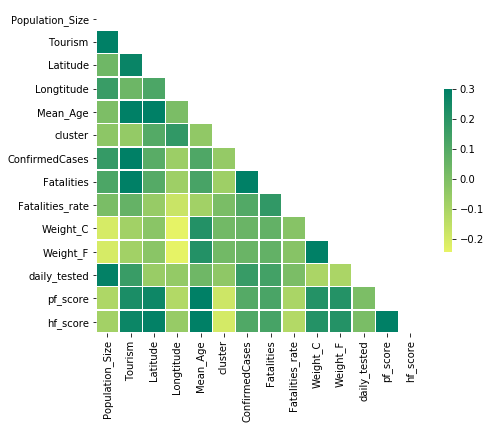

In [104]:
import seaborn as sns
corr = data.drop(["Id"],axis=1).corr()
mask = np.zeros_like(corr, dtype=np.bool)
mask[np.triu_indices_from(mask)] = True
f, ax = plt.subplots(figsize=(8, 6))

sns.heatmap(corr, 
            xticklabels=corr.columns.values,
            yticklabels=corr.columns.values,mask=mask,cmap='summer_r',vmax=.3, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": 0.5})

## Feature importance with random forest

In [105]:
def feature_imp(df,model):
    fi = pd.DataFrame()
    fi["feature"] = df.columns
    fi["importance"] = model.feature_importances_
    return fi.sort_values(by="importance", ascending=False)

In [106]:
train = data.copy()

In [107]:
train.Date_FirstFatality.fillna("2222-11-11",inplace=True)
train.Date_FirstFatality=pd.to_datetime(train.Date_FirstFatality)
train.Date_FirstFatality = train.Date_FirstFatality.astype(np.int64) // 10**9

train.Date_FirstConfirmedCase=pd.to_datetime(train.Date_FirstConfirmedCase)
train.Date_FirstConfirmedCase = train.Date_FirstConfirmedCase.astype(np.int64) // 10**9

train.Date=pd.to_datetime(train.Date)
train.Date = train.Date.astype(np.int64) // 10**9

train.Lockdown_Date.fillna("2111-12-12",inplace=True)
train.Lockdown_Date=pd.to_datetime(train.Lockdown_Date)
train.Lockdown_Date = train.Lockdown_Date.astype(np.int64) // 10**9


train.Lockdown_Type = train.Lockdown_Type.astype("category")
train.Lockdown_Type = train.Lockdown_Type.cat.codes

train.diff_FC_LD.replace({np.NAN:"62"},inplace=True)
train.diff_FF_LD.replace({np.NAN:"42"},inplace=True)
train.diff_FC_LD=train.diff_FC_LD.astype(str)
train.diff_FF_LD=train.diff_FF_LD.astype(str)
train.diff_FC_LD=train.diff_FC_LD.str[:2]
train.diff_FF_LD=train.diff_FF_LD.str[:2]
train.diff_FC_LD = train.diff_FC_LD.astype(int)
train.diff_FF_LD = train.diff_FF_LD.astype(int)

In [108]:
train = train[train.Date == max(train.Date)]

In [109]:
# Random Forest Regressor
rf = RandomForestRegressor(n_estimators = 1000,
                           n_jobs = -1,
                           random_state = 141)
rf.fit(train.drop(['Country_Region',"Id","Fatalities","ConfirmedCases","Fatalities_rate","Date","Country_Code","Date_FirstFatality","Date_FirstConfirmedCase","Lockdown_Date"],axis=1), train["Fatalities"])

RandomForestRegressor(bootstrap=True, ccp_alpha=0.0, criterion='mse',
                      max_depth=None, max_features='auto', max_leaf_nodes=None,
                      max_samples=None, min_impurity_decrease=0.0,
                      min_impurity_split=None, min_samples_leaf=1,
                      min_samples_split=2, min_weight_fraction_leaf=0.0,
                      n_estimators=1000, n_jobs=-1, oob_score=False,
                      random_state=141, verbose=0, warm_start=False)

In [110]:
fimp = feature_imp(train.drop(['Country_Region',"Id","Fatalities","ConfirmedCases","Fatalities_rate","Date","Country_Code","Date_FirstFatality","Date_FirstConfirmedCase","Lockdown_Date"],axis=1),rf)

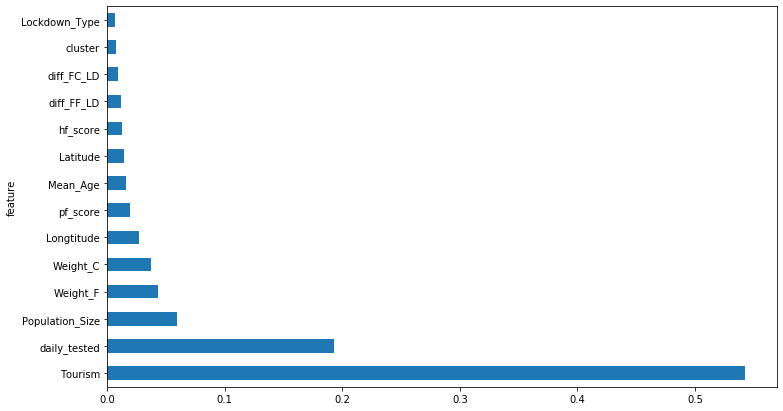

In [111]:
feature_imp(train.drop(['Country_Region',"Id","Fatalities","ConfirmedCases","Fatalities_rate","Date","Country_Code","Date_FirstFatality","Date_FirstConfirmedCase","Lockdown_Date"],axis=1),rf).plot('feature', 'importance', 'barh', figsize=(12,7), legend=False)

### Checking the correlation between the Fatalities, Tourism and population size

In [112]:
fig = px.scatter(data[(data.Tourism>100000) & (data.Date == max(data.Date)) ],
                 x='Tourism', y='Fatalities', color='Country_Region', size='Mean_Age', height=700, text='Country_Region',log_x=True,log_y=True)
fig.update_traces(textposition='top center')
fig.update_layout(showlegend=False)
fig.update_layout(xaxis_rangeslider_visible=True)
fig.show()

In [113]:
fig = px.scatter(data[(data.Population_Size>100000) & (data.Date == max(data.Date)) ],
                 x='Population_Size', y='Fatalities', color='Country_Region', size='Mean_Age', height=700,
                 text='Country_Region',log_x=True,log_y=True)
fig.update_traces(textposition='top center')
fig.update_layout(showlegend=False)
fig.update_layout(xaxis_rangeslider_visible=True)
fig.show()

In [114]:
fig = px.scatter(data[(data.Population_Size>100000) & (data.Date == max(data.Date)) ],
                 x='Weight_F', y='Fatalities', color='Country_Region', size='Mean_Age', height=700,
                 text='Country_Region',log_x=True,log_y=True)
fig.update_traces(textposition='top center')
fig.update_layout(showlegend=False)
fig.update_layout(xaxis_rangeslider_visible=True)
fig.show()

In [115]:
fig = px.scatter(data[(data.daily_tested>200) & (data.Date == max(data.Date)) ],
                 x='daily_tested', y='Fatalities', color='Country_Region', size='Mean_Age', height=700,
                 text='Country_Region',log_x=True,log_y=True)
fig.update_traces(textposition='top center')
fig.update_layout(showlegend=False)
fig.update_layout(xaxis_rangeslider_visible=True)
fig.show()

# Predicting the ConfirmCases From Fatalities

In [116]:
data.sort_values(["Country_Region"],inplace=True)

In [117]:
def predict_ConfirmedCases(test_country):
    tmp_data=data[(data.Date == max(data.Date))]
    test_data=tmp_data[tmp_data.Country_Region == test_country]
    train_data = tmp_data[(tmp_data.Country_Region !=test_country) & (tmp_data.Fatalities_rate >= 2) & (tmp_data.Fatalities_rate <= 6)]
    #print(test_data)
    
    mms.fit(train_data[['Fatalities',"Population_Size","Tourism"]])
    data_transformed = mms.transform(train_data[['Fatalities',"Population_Size","Tourism"]])
    
    rg = Ridge(alpha=0.00001)
    rg.fit(data_transformed,train_data["ConfirmedCases"])
   
    predictions=rg.predict(mms.transform(test_data[['Fatalities',"Population_Size","Tourism"]]))
    return pd.DataFrame([test_country,predictions[0]]).transpose()

In [118]:
tmp_df = pd.DataFrame([data.Country_Region.unique()]).T

In [119]:
tmp_df.columns =["Country_Region"]

In [120]:
for i in data.Country_Region.unique():
    d=predict_ConfirmedCases(i)
    tmp_df.loc[tmp_df.Country_Region == i,"predicted_C"] = predict_ConfirmedCases(i)[1].values[0]

In [121]:
tmp_df=pd.merge(tmp_df, data.loc[(data.Date == max(data.Date)),["ConfirmedCases","Country_Region"]],how="left",on="Country_Region")

In [122]:
tmp_df.predicted_C = tmp_df.predicted_C.apply(lambda x: int(round(x,2)))

In [123]:
tmp_df[tmp_df.Country_Region.isin(["Morocco","Egypt","Algeria","Tunisia","France","Spain","Italy","Korea, South"])]

,Country_Region,predicted_C,ConfirmedCases
2,Algeria,12842,6629.0
53,Egypt,15854,11228.0
62,France,600478,179630.0
85,Italy,680695,223885.0
91,"Korea, South",9666,11037.0
117,Morocco,7591,6652.0
157,Spain,597581,230183.0
170,Tunisia,3745,1035.0
